In [1]:
%matplotlib inline

In [2]:
from datetime import datetime
import os
from os.path import dirname, abspath, join
from os import getcwd
import sys

In [3]:
import random
import string
import pandas as pd
import numpy as np

In [4]:
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker

In [5]:
import torch
import socket
from IPython.display import clear_output

In [6]:
# seed_arg = int(sys.argv[1])
# print ("\n\nSeed ARG: ",seed_arg)
seed_arg = 1

In [7]:
seedlist = np.array([161, 314, 228, 271828, 230, 4271031, 5526538, 6610165, 9849252, 34534, 73422, 8765])
seed = seedlist[seed_arg]
random.seed(seed)
torch.manual_seed(seed)
torch.cuda.manual_seed(seed)
np.random.seed(seed)
os.environ['PYTHONHASHSEED'] = str(seed)

In [8]:
NAME       = 'B1_2_wakkanai_alt_depth2_w100'
MODELNAME  = NAME + '_' + str(seed) + '.pt'
print("\nMODEL : ", NAME)
print("SEED  : ",seed_arg)
print("HOST  : ",socket.gethostname())
print("START : ",datetime.now())


MODEL :  B1_2_wakkanai_alt_depth2_w100
SEED  :  1
HOST  :  7574709303cc
START :  2019-03-17 22:00:47.576463


In [9]:
class ENO(object):
    
    #no. of forecast types is 6 ranging from 0 to 5
  
    def __init__(self, location='tokyo', year=2010, shuffle=False, day_balance=False):
        self.location = location
        self.year = year
        self.day = None
        self.hr = None
        
        self.shuffle = shuffle
        self.day_balance = day_balance

        self.TIME_STEPS = None #no. of time steps in one episode
        self.NO_OF_DAYS = None #no. of days in one year
        
        self.NO_OF_DAYTYPE = 10 #no. of daytypes
        self.daycounter = 0 #to count number of days that have been passed
        
        self.sradiation = None #matrix with GSR for the entire year
        self.senergy = None #matrix with harvested energy data for the entire year
        self.fforecast = None #array with forecast values for each day
        

        self.henergy = None #harvested energy variable
        self.fcast = None #forecast variable
        self.sorted_days = [] #days sorted according to day type
        
        self.SMAX = 1000 # 1 Watt Solar Panel

    
    #function to get the solar data for the given location and year and prep it
    def get_data(self):
        #solar_data/CSV files contain the values of GSR (Global Solar Radiation in MegaJoules per meters squared per hour)
        #weather_data/CSV files contain the weather summary from 06:00 to 18:00 and 18:00 to 06:00+1
        location = self.location
        year = self.year

        THIS_DIR = getcwd()
        SDATA_DIR = abspath(join(THIS_DIR, 'solar_data'))  #abspath(join(THIS_DIR, '../../..', 'data'))
        
        sfile = SDATA_DIR + '/' + location +'/' + str(year) + '.csv'
        
        #skiprows=4 to remove unnecessary title texts
        #usecols=4 to read only the Global Solar Radiation (GSR) values
        solar_radiation = pd.read_csv(sfile, skiprows=4, encoding='shift_jisx0213', usecols=[4])
      
        #convert dataframe to numpy array
        solar_radiation = solar_radiation.values

        #convert missing data in CSV files to zero
        solar_radiation[np.isnan(solar_radiation)] = 0

        #reshape solar_radiation into no_of_daysx24 array
        solar_radiation = solar_radiation.reshape(-1,24)

        if(self.shuffle): #if class instatiation calls for shuffling the day order. Required when learning
            np.random.shuffle(solar_radiation) 
        self.sradiation = solar_radiation
        
        #GSR values (in MJ/sq.mts per hour) need to be expressed in mW
        # Conversion is accomplished by 
        # solar_energy = GSR(in MJ/m2/hr) * 1e6 * size of solar cell * efficiency of solar cell /(60x60) *1000 (to express in mW)
        # the factor of 2 in the end is assuming two solar cells
        self.senergy = 2*self.sradiation * 1e6 * (55e-3 * 70e-3) * 0.15 * 1000/(60*60)

        return 0
    
    #function to map total day radiation into type of day ranging from 0 to 5
    #the classification into day types is quite arbitrary. There is no solid logic behind this type of classification.
    
    def get_day_state(self,tot_day_radiation):
        bin_edges = np.array([0, 3.5, 6.5, 9.0, 12.5, 15.5, 18.5, 22.0, 25, 28])
        for k in np.arange(1,bin_edges.size):
            if (bin_edges[k-1] < tot_day_radiation <= bin_edges[k]):
                day_state = k -1
            else:
                day_state = bin_edges.size - 1
        return int(day_state)
    
    def get_forecast(self):
        #create a perfect forecaster.
        tot_day_radiation = np.sum(self.sradiation, axis=1) #contains total solar radiation for each day
        get_day_state = np.vectorize(self.get_day_state)
        self.fforecast = get_day_state(tot_day_radiation)
        
        #sort days depending on the type of day and shuffle them; maybe required when learning
        for fcast in range(0,6):
            fcast_days = ([i for i,x in enumerate(self.fforecast) if x == fcast])
            np.random.shuffle(fcast_days)
            self.sorted_days.append(fcast_days)
        return 0
    
    def reset(self,day=0): #it is possible to reset to the beginning of a certain day
        
        self.get_data() #first get data for the given year
        self.get_forecast() #calculate the forecast
        
        self.TIME_STEPS = self.senergy.shape[1]
        self.NO_OF_DAYS = self.senergy.shape[0]
        
        self.day = day
        self.hr = 0
        
        self.henergy = self.senergy[self.day][self.hr]
        self.fcast = self.fforecast[self.day]
        
        end_of_day = False
        end_of_year = False
        return [self.henergy, self.fcast, end_of_day, end_of_year]

    
    def step(self):
        end_of_day = False
        end_of_year = False
        if not(self.day_balance): #if daytype balance is not required
            if(self.hr < self.TIME_STEPS - 1):
                self.hr += 1
                self.henergy = self.senergy[self.day][self.hr] 
                self.fcast = self.fforecast[self.day]
            else:
                if(self.day < self.NO_OF_DAYS -1):
                    end_of_day = True
                    self.hr = 0
                    self.day += 1
                    self.henergy = self.senergy[self.day][self.hr] 
                    self.fcast = self.fforecast[self.day]
                else:
                    end_of_day = True
                    end_of_year = True
                    
        else: #when training, we want all daytypes to be equally represented for robust policy
              #obviously, the days are going to be in random order
            if(self.hr < self.TIME_STEPS - 1):
                self.hr += 1
                self.henergy = self.senergy[self.day][self.hr]
                self.fcast = self.fforecast[self.day]
            else:
                if(self.daycounter < self.NO_OF_DAYS -1):
                    end_of_day = True
                    self.daycounter += 1
                    self.hr = 0
                    daytype = random.choice(np.arange(0,self.NO_OF_DAYTYPE)) #choose random daytype
                    self.day = np.random.choice(self.sorted_days[daytype]) #choose random day from that daytype
                    self.henergy = self.senergy[self.day][self.hr] 
                    self.fcast = self.fforecast[self.day]
                else: 
                    end_of_day = True
                    end_of_year = True
                    self.daycounter = 0
        
        
        return [self.henergy, self.fcast, end_of_day, end_of_year]

In [10]:
class CAPM (object):
    def __init__(self,location='tokyo', year=2010, shuffle=False, trainmode=False):

        #all energy values i.e. BMIN, BMAX, BOPT, HMAX are in mWhr. Assuming one timestep is one hour
        
        self.BMIN = 0.0                #Minimum battery level that is tolerated. Maybe non-zero also
        self.BMAX = 10000.0            #Max Battery Level. May not necessarily be equal to total batter capacity [3.6V x 2500mAh]
        self.BOPT = 0.5 * self.BMAX    #Optimal Battery Level. Assuming 50% of battery is the optimum
        self.BLIM_LO = 0.15*self.BMAX
        self.BLIM_HI = 0.95*self.BMAX
        self.BSAFE_LO = 0.35*self.BMAX
        self.BSAFE_HI = 0.65*self.BMAX
        
        self.ENP_MARGIN = 0.3*self.BMAX

        
        self.HMIN = 0      #Minimum energy that can be harvested by the solar panel.
        self.HMAX = None   #Maximum energy that can be harvested by the solar panel. [500mW]
        
        self.DMAX = 500      #Maximum energy that can be consumed by the node in one time step. [~ 3.6V x 135mA]
        self.N_ACTIONS = 10  #No. of different duty cycles possible
        self.DMIN = self.DMAX/self.N_ACTIONS #Minimum energy that can be consumed by the node in one time step. [~ 3.6V x 15mA]
        
        self.binit = None     #battery at the beginning of day
        self.btrack = []      #track the mean battery level for each day
        self.atrack = []      #track the duty cycles for each day
        self.htrack = []      #track the harvested for each day
        self.batt = None      #battery variable
        self.enp = None       #enp at end of hr
        self.henergy = None   #harvested energy variable
        self.fcast = None     #forecast variable
        
        self.MUBATT = 0.6
        self.SDBATT = 0.02
        
        self.MUHENERGY = 0.5
        self.SDHENERGY = 0.2
        
        self.MUENP = 0
        self.SDENP = 0.02
        
        self.location  = location
        self.year      = year
        self.shuffle   = shuffle
        self.trainmode = trainmode
        self.eno       = None
        
        self.day_violation_flag = False
        self.violation_flag     = False
        self.violation_counter  = 0
        
        self.batt_violations    = 0

        self.NO_OF_DAYTYPE      = 10 #no. of daytypes
 
    def reset(self,day=0,batt=-1):
        henergy, fcast, day_end, year_end = self.eno.reset(day) #reset the eno environment
        self.violation_flag = False
        self.violation_counter = 0
        self.batt_violations = 0
        
        if(batt == -1):
            self.batt = self.BOPT
        else:
            self.batt = batt
            
        self.batt = np.clip(self.batt, self.BMIN, self.BMAX)
        self.binit = self.batt
        self.btrack = np.append(self.btrack, self.batt) #track battery levels

        self.enp = self.BOPT - self.batt
#         self.enp = self.binit - self.batt #enp is calculated
        self.henergy = np.clip(henergy, self.HMIN, self.HMAX) #clip henergy within HMIN and HMAX
        self.fcast = fcast
        
        norm_batt    = self.batt    /self.BMAX
        norm_enp     = self.enp     /self.BMAX
        norm_henergy = self.henergy /self.HMAX
        norm_fcast   = self.fcast   /(self.NO_OF_DAYTYPE-1)
        c_state = [norm_batt, norm_enp, norm_henergy, norm_fcast] #continuous states

        reward = 0
        
        return [c_state, reward, day_end, year_end]
    
    def getstate(self): #query the present state of the system
        norm_batt    = self.batt    /self.BMAX
        norm_enp     = self.enp     /self.BMAX
        norm_henergy = self.henergy /self.HMAX
        norm_fcast   = self.fcast   /(self.NO_OF_DAYTYPE-1)
        c_state = [norm_batt, norm_enp, norm_henergy, norm_fcast] #continuous states

        return c_state
        
    
    #reward function
    def rewardfn(self):
        violation_penalty = 0
        bmean = self.btrack.mean()
        bdev = self.BOPT - bmean
        if np.abs(bdev) > (self.BOPT - self.BLIM_LO):
            reward = 2-np.abs(bdev)/self.BMAX*10
        else:
            reward = 2
#         reward = 2 - 20*np.abs(bdev)/self.BMAX
        if(self.day_violation_flag):
            violation_penalty += 3    #penalty for violating battery limits anytime during the day
        return (reward - violation_penalty)
    
    
    
    def step(self, action):
        day_end = False
        year_end = False
        self.violation_flag = False
        reward = 0
        self.atrack = np.append(self.atrack, action+1) #track duty cycles
        self.htrack = np.append(self.htrack, self.henergy)

#         action_var = np.abs(np.mean(self.atrack) - action)/9 #can vary from 0 to 1
#         reward += 0.25*(0.5 - action_var ) #reward penalizing high duty cycle variance [-0.5 to 0.5]*0.25
      
        action = np.clip(action, 0, self.N_ACTIONS-1) #action values range from (0 to N_ACTIONS-1)
        e_consumed = (action+1)*self.DMAX/self.N_ACTIONS   #energy consumed by the node
        
        
        self.batt += (self.henergy - e_consumed)
        if(self.batt <= self.BMIN or self.batt >= self.BMAX ):
                self.batt_violations += 1
        
        if(self.batt < self.BLIM_LO or self.batt > self.BLIM_HI ):
            self.violation_flag = True #penalty for violating battery limits everytime it happens
#             reward -= 2
#             if(self.batt < self.BLIM_LO): #battery depletion is more fatal than battery overflow
#                 reward -= 2

        if(self.violation_flag):
            if(self.day_violation_flag == False): #penalty for violating battery limits anytime during the day - triggers once everyday
                self.violation_counter += 1
                self.day_violation_flag = True
                
        #calculate ENP before clipping
        self.enp = self.BOPT - self.batt
        
        self.batt = np.clip(self.batt, self.BMIN, self.BMAX) #clip battery values within permitted level
        self.btrack = np.append(self.btrack, self.batt) #track battery levels
        
        
        #proceed to the next time step
       
        self.henergy, self.fcast, day_end, year_end = self.eno.step()
        self.henergy = np.clip(self.henergy, self.HMIN, self.HMAX) #clip henergy within HMIN and HMAX
                        
        if(day_end): #if eno object flags that the day has ended then give reward
            reward += self.rewardfn()
            if (self.trainmode): #reset battery to optimal level if limits are exceeded when training
#                 self.batt = np.random.uniform(self.DMAX*self.eno.TIME_STEPS/self.BMAX,0.8)*self.BMAX
#                 if (self.violation_flag):
                if np.random.uniform() < HELP : #occasionaly reset the battery
                    self.batt = self.BOPT  
            
            self.day_violation_flag = False
            self.binit = self.batt #this will be the new initial battery level for next day
            self.btrack = [] #clear battery tracker
            self.atrack = [] #clear duty cycle tracker
            self.htrack = [] #clear henergy tracker
   
        norm_batt    = self.batt    /self.BMAX
        norm_enp     = self.enp     /self.BMAX
        norm_henergy = self.henergy /self.HMAX
        norm_fcast   = self.fcast   /(self.NO_OF_DAYTYPE-1)
        c_state = [norm_batt, norm_enp, norm_henergy, norm_fcast] #continuous states
        
        return [c_state, reward, day_end, year_end]

In [11]:
# Hyper Parameters
BATCH_SIZE          = 12
WT_DECAY            = None
LR                  = 1e-4          # learning rate
EPSILON             = 0.9           # greedy policy
GAMMA               = 0.9           # reward discount
LAMBDA              = 0.95          # parameter decay
TARGET_REPLACE_ITER = 24*7*4*18     # target update frequency
MEMORY_CAPACITY     = 24*7*4*12*3   # store upto six month worth of memory   

N_ACTIONS           = 10            # no. of duty cycles (0,1,2,3,4)
N_STATES            = 4             # number of state space parameter [batt, enp, henergy, fcast]

HIDDEN_LAYER        = 100            # width of NN
NO_OF_ITERATIONS    = 100
GPU                 = False         # device
HELP                = 0.05

In [12]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import numpy as np

#Class definitions for NN model and learning algorithm
class Net(nn.Module):
    def __init__(self):
        super(Net, self).__init__()

        self.fc1 = nn.Linear(N_STATES, HIDDEN_LAYER)
        nn.init.kaiming_uniform_(self.fc1.weight)
        
        self.fc2 = nn.Linear(HIDDEN_LAYER, HIDDEN_LAYER)
        nn.init.kaiming_uniform_(self.fc2.weight)
        
#         self.fc3 = nn.Linear(HIDDEN_LAYER, HIDDEN_LAYER)
#         nn.init.kaiming_uniform_(self.fc3.weight)

        self.fc_out = nn.Linear(HIDDEN_LAYER, N_ACTIONS)
        nn.init.xavier_uniform_(self.fc_out.weight) 
    
    def forward(self, x):
        x = self.fc1(x)
        x = F.relu(x)
#         x = F.leaky_relu(x)
        x = self.fc2(x)
        x = F.relu(x)
#         x = self.fc3(x)
#         x = F.relu(x)
        x = self.fc_out(x)
        return x
    
class DQN(object):
    def __init__(self):
        if(GPU): 
            device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
        else:
            device = torch.device('cpu')
        self.eval_net, self.target_net = Net(), Net()
        self.eval_net.to(device)
        self.target_net.to(device)
        self.device = device
#         print("Neural net")
#         print(self.eval_net)
        self.learn_step_counter = 0                                     # for target updating
        self.good_memory_counter = 0                                         # for storing memory
        self.good_memory = np.zeros((MEMORY_CAPACITY, N_STATES * 2 + 2))     # initialize memory [mem: ([s], a, r, [s_]) ]
        
        self.bad_memory_counter = 0                                         # for storing memory
        self.bad_memory = np.zeros((MEMORY_CAPACITY, N_STATES * 2 + 2))     # initialize memory [mem: ([s], a, r, [s_]) ]
        
        
        self.optimizer = torch.optim.Adam(self.eval_net.parameters(), lr=LR)
#         self.optimizer = torch.optim.Adam(self.eval_net.parameters(), lr=LR, weight_decay=WT_DECAY)
#         self.loss_func = nn.SmoothL1Loss()
        self.loss_func = nn.MSELoss()
        self.nettoggle = False

    def choose_action(self, x):
        x = torch.unsqueeze(torch.FloatTensor(x), 0)
        x = x.to(self.device)

        actions_value = self.eval_net.forward(x)
        actions_value = actions_value.to(torch.device("cpu"))
        action = torch.max(actions_value, 1)[1].data.numpy()
        action = action[0] # return the argmax index
        if np.random.uniform() > EPSILON:   # greedy
            action += np.random.randint(-3, 3)
            action = int(np.clip(action, 0, N_ACTIONS-1))
        return action
    
    def choose_greedy_action(self, x):
        x = torch.unsqueeze(torch.FloatTensor(x), 0)
        x = x.to(self.device)

        # input only one sample
        if True:   # greedy
            actions_value = self.eval_net.forward(x)
            actions_value = actions_value.to(torch.device("cpu"))
            action = torch.max(actions_value, 1)[1].data.numpy()
            action = action[0] # return the argmax index
        return action

    def store_transition(self, s, a, r, s_):
        transition = np.hstack((s, [a, r], s_))
        # replace the old memory with new memory
        index = self.memory_counter % MEMORY_CAPACITY
        self.memory[index, :] = transition
        self.memory_counter += 1
    
    def store_day_transition(self, transition):
      
        if(transition[-1][5] < 0):
            index = self.bad_memory_counter % MEMORY_CAPACITY
            self.bad_memory= np.insert(self.bad_memory, index, transition,0)
            self.bad_memory_counter += transition.shape[0]
            self.bad_memory=self.bad_memory[:int(MEMORY_CAPACITY)]
        
        else:
            index = self.good_memory_counter % MEMORY_CAPACITY
            self.good_memory= np.insert(self.good_memory, index, transition,0)
            self.good_memory_counter += transition.shape[0]
            self.good_memory=self.good_memory[:int(MEMORY_CAPACITY)]

    def learn(self):
        # target parameter update
        if self.learn_step_counter % TARGET_REPLACE_ITER == 0:
            self.target_net.load_state_dict(self.eval_net.state_dict())
            self.nettoggle = not self.nettoggle
        self.learn_step_counter += 1

        # sample batch transitions
        good_sample_index = np.random.choice(int(MEMORY_CAPACITY), int(0.5*BATCH_SIZE))
        bad_sample_index  = np.random.choice(int(MEMORY_CAPACITY), BATCH_SIZE - int(BATCH_SIZE*0.50))

        b_good_memory = self.good_memory[good_sample_index, :]
        b_bad_memory = self.bad_memory[bad_sample_index, :]
        b_memory = np.vstack((b_good_memory,b_bad_memory))

        b_s = torch.FloatTensor(b_memory[:, :N_STATES])
        b_a = torch.LongTensor(b_memory[:, N_STATES:N_STATES+1].astype(int))
        b_r = torch.FloatTensor(b_memory[:, N_STATES+1:N_STATES+2])
        b_s_ = torch.FloatTensor(b_memory[:, -N_STATES:])
        
        b_s = b_s.to(self.device)
        b_a = b_a.to(self.device)
        b_r = b_r.to(self.device)
        b_s_ = b_s_.to(self.device)

        # q_eval w.r.t the action in experience
        q_eval = self.eval_net(b_s).gather(1, b_a)  # shape (batch, 1)
        q_next = self.target_net(b_s_).detach()     # detach from graph, don't backpropagate
        q_target = b_r + GAMMA * q_next.max(1)[0].view(BATCH_SIZE, 1)   # shape (batch, 1)
        loss = self.loss_func(q_eval, q_target)

        self.optimizer.zero_grad()
        loss.backward()
        self.optimizer.step()

In [13]:
def stdize(s):
    MU_BATT = 0.5
    SD_BATT = 0.15
    
    MU_ENP = 0
    SD_ENP = 0.15
    
    MU_HENERGY = 0.35
    SD_HENERGY = 0.25
    
    MU_FCAST = 0.42
    SD_FCAST = 0.27
    
    norm_batt, norm_enp, norm_henergy, norm_fcast = s
    
    std_batt    = (norm_batt    - MU_BATT    )/SD_BATT
    std_enp     = (norm_enp     - MU_ENP     )/SD_ENP
    std_henergy = (norm_henergy - MU_HENERGY )/SD_HENERGY
    std_fcast   = (norm_fcast   - MU_FCAST   )/SD_FCAST

    return [std_batt, std_enp, std_henergy, std_fcast]


In [14]:
#CONSTANTS
LOCATION = 'tokyo'
YEAR = 2010
capm      = CAPM(LOCATION,YEAR,shuffle=False, trainmode=False) #instantiate the CAPM class
print("BMIN       = ", capm.BMIN)
print("BMAX       = ", capm.BMAX)
print("BOPT       = ", capm.BOPT)
print("BLIM_LO    = ", capm.BLIM_LO)
print("BLIM_HI    = ", capm.BLIM_HI)
print("BSAFE_LO   = ", capm.BSAFE_LO)
print("BSAFE_HI   = ", capm.BSAFE_HI)
print("ENP_MARGIN = ", capm.ENP_MARGIN)

BMIN       =  0.0
BMAX       =  10000.0
BOPT       =  5000.0
BLIM_LO    =  1500.0
BLIM_HI    =  9500.0
BSAFE_LO   =  3500.0
BSAFE_HI   =  6500.0
ENP_MARGIN =  3000.0


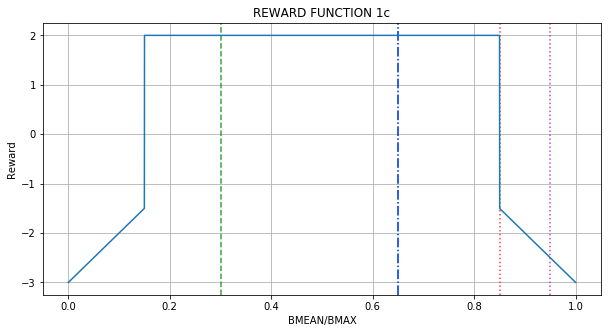

RF_1c(0)            =  -3.00
RF_1c(ENP_MARGIN/4) =  -3.00
RF_1c(ENP_MARGIN/2) =  -3.00
RF_1c(ENP_MARGIN)   =  -3.00

RF_1c(BMAX/2) =  -3.00
RF_1c(BMAX)   =  -3.00



In [15]:
#PLOT REWARD FUNCTIONS
x = np.arange(0,capm.BMAX)
y = [capm.rewardfn() for capm.btrack in x]

fig = plt.figure(figsize=(10,5))
ax = fig.add_subplot(111)
ax.set_title('REWARD FUNCTION 1c')
ax.set_xlabel('BMEAN/BMAX')
ax.set_ylabel('Reward')
ax.axvline((capm.ENP_MARGIN)/capm.BMAX, color='g',alpha=0.75, linestyle='--')
ax.axvline(1-(capm.BSAFE_LO)/capm.BMAX, color='c',alpha=0.75, linestyle='-.')
ax.axvline(  (capm.BSAFE_HI)/capm.BMAX, color='b',alpha=0.75, linestyle="-.")
ax.axvline(1- (capm.BLIM_LO)/capm.BMAX, color='r',alpha=0.75, linestyle=':')
ax.axvline(   (capm.BLIM_HI)/capm.BMAX, color='m',alpha=0.75, linestyle=":")
ax.plot(x/capm.BMAX,y)
ax.grid(True)
plt.show()

capm.enp = 0;            print("RF_1c(0)            = {:6.2f}".format(capm.rewardfn()) )
capm.enp = capm.ENP_MARGIN/4; print("RF_1c(ENP_MARGIN/4) = {:6.2f}".format(capm.rewardfn()) )
capm.enp = capm.ENP_MARGIN/2; print("RF_1c(ENP_MARGIN/2) = {:6.2f}".format(capm.rewardfn()) )
capm.enp = capm.ENP_MARGIN;   print("RF_1c(ENP_MARGIN)   = {:6.2f}".format(capm.rewardfn()) )
print("");
capm.enp = capm.BMAX/2; print("RF_1c(BMAX/2) = {:6.2f}".format(capm.rewardfn()) )
capm.enp = capm.BMAX;   print("RF_1c(BMAX)   = {:6.2f}".format(capm.rewardfn()) )
print("");

In [16]:
#TRAINING STARTS
tic = datetime.now()

Device:  cpu

Iteration 0:  WAKKANAI, 2003 
EPSILON = 5.000e-01
LR = 3.392e-05
Average Terminal Reward  = -3.872
Day Violations           =    333
Battery Limit Violations =   3813
Action MEAN              =  5.008
Action STD DEV           =  1.700


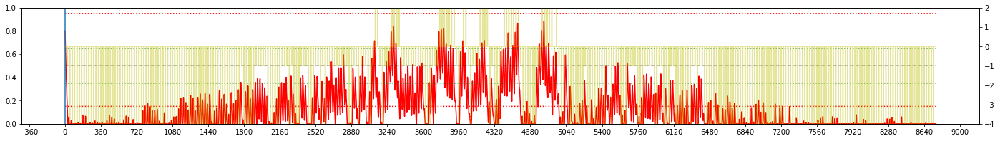


Iteration 1:  WAKKANAI, 2007 
EPSILON = 5.000e-01
LR = 4.174e-05
Average Terminal Reward  = -4.030
Day Violations           =    333
Battery Limit Violations =   4075
Action MEAN              =  4.994
Action STD DEV           =  1.705


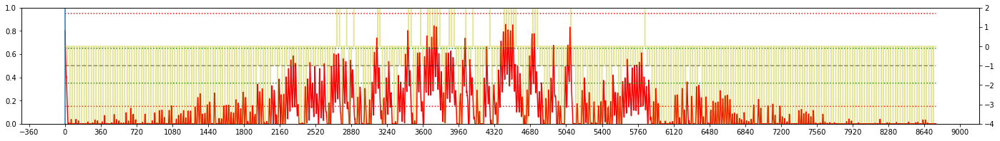


Iteration 2:  WAKKANAI, 2001 
EPSILON = 5.000e-01
LR = 5.000e-05
Average Terminal Reward  = -4.086
Day Violations           =    334
Battery Limit Violations =   4396
Action MEAN              =  5.007
Action STD DEV           =  1.710


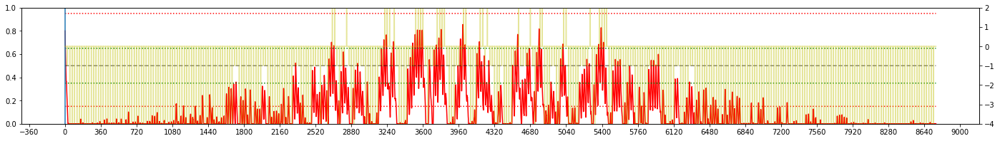


Iteration 3:  WAKKANAI, 2002 
EPSILON = 5.000e-01
LR = 5.826e-05
Average Terminal Reward  = -3.987
Day Violations           =    335
Battery Limit Violations =   4177
Action MEAN              =  4.976
Action STD DEV           =  1.720


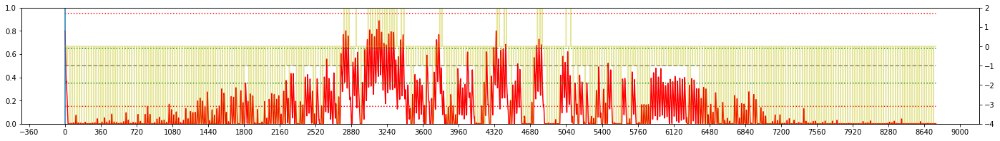


Iteration 4:  WAKKANAI, 2000 
EPSILON = 5.001e-01
LR = 6.608e-05
Average Terminal Reward  = -4.304
Day Violations           =    340
Battery Limit Violations =   4382
Action MEAN              =  4.910
Action STD DEV           =  1.587


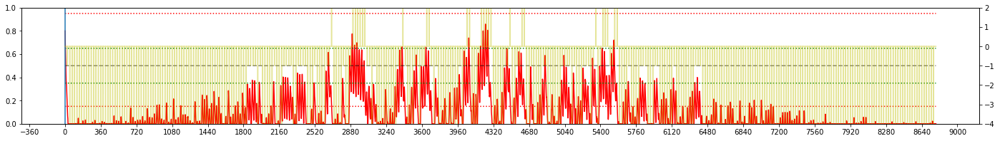


Iteration 5:  WAKKANAI, 2004 
EPSILON = 5.001e-01
LR = 7.311e-05
Average Terminal Reward  = -4.058
Day Violations           =    336
Battery Limit Violations =   4177
Action MEAN              =  5.011
Action STD DEV           =  1.673


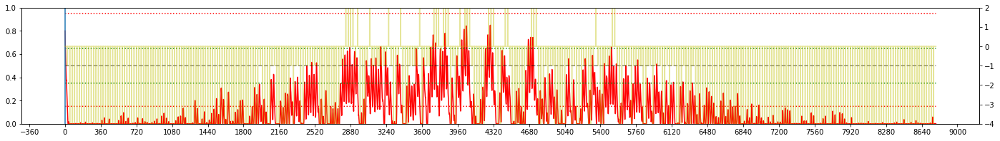


Iteration 6:  WAKKANAI, 2003 
EPSILON = 5.001e-01
LR = 7.914e-05
Average Terminal Reward  = -3.822
Day Violations           =    331
Battery Limit Violations =   3822
Action MEAN              =  5.027
Action STD DEV           =  1.701


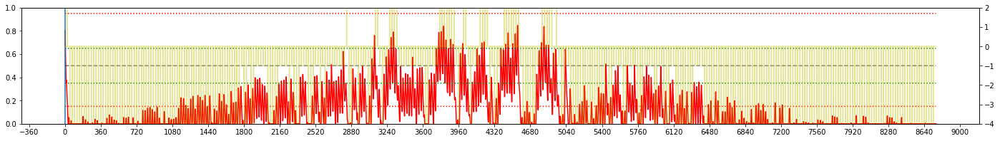


Iteration 7:  WAKKANAI, 2006 
EPSILON = 5.001e-01
LR = 8.411e-05
Average Terminal Reward  = -4.157
Day Violations           =    332
Battery Limit Violations =   4337
Action MEAN              =  5.000
Action STD DEV           =  1.666


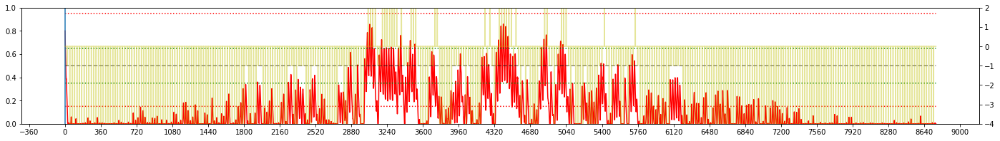


Iteration 8:  WAKKANAI, 2003 
EPSILON = 5.001e-01
LR = 8.808e-05
Average Terminal Reward  = -3.787
Day Violations           =    328
Battery Limit Violations =   3840
Action MEAN              =  5.020
Action STD DEV           =  1.714


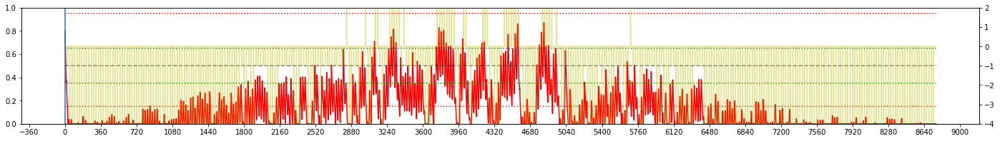


Iteration 9:  WAKKANAI, 2006 
EPSILON = 5.001e-01
LR = 9.116e-05
Average Terminal Reward  = -4.179
Day Violations           =    332
Battery Limit Violations =   4313
Action MEAN              =  4.986
Action STD DEV           =  1.675


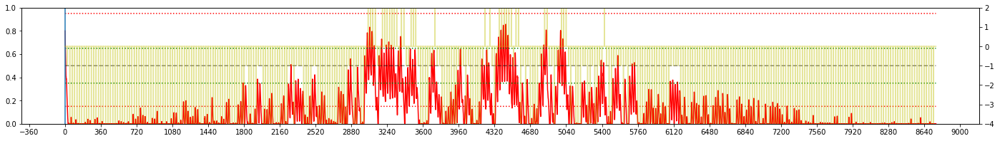


Iteration 10:  WAKKANAI, 2008 
EPSILON = 5.002e-01
LR = 9.350e-05
Average Terminal Reward  = -4.097
Day Violations           =    332
Battery Limit Violations =   4189
Action MEAN              =  4.993
Action STD DEV           =  1.679


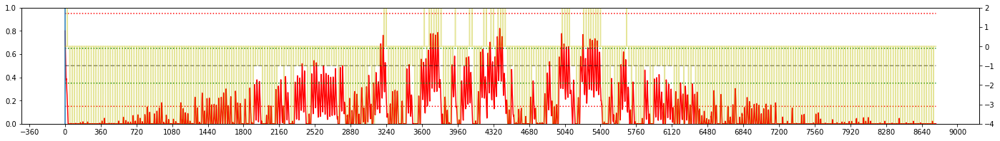


Iteration 11:  WAKKANAI, 2007 
EPSILON = 5.002e-01
LR = 9.526e-05
Average Terminal Reward  = -4.033
Day Violations           =    333
Battery Limit Violations =   4086
Action MEAN              =  5.004
Action STD DEV           =  1.710


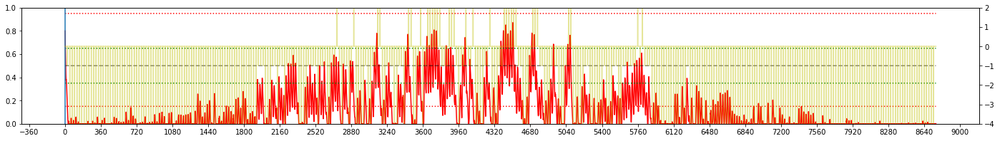


Iteration 12:  WAKKANAI, 2000 
EPSILON = 5.003e-01
LR = 9.656e-05
Average Terminal Reward  = -4.312
Day Violations           =    344
Battery Limit Violations =   4377
Action MEAN              =  4.918
Action STD DEV           =  1.596


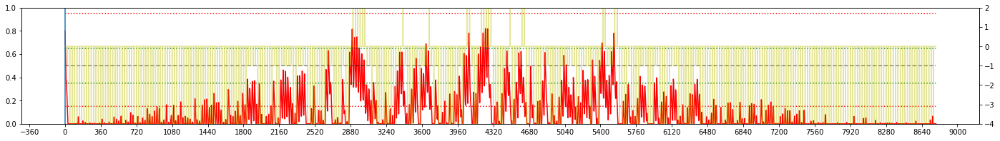


Iteration 13:  WAKKANAI, 2002 
EPSILON = 5.003e-01
LR = 9.751e-05
Average Terminal Reward  = -3.932
Day Violations           =    330
Battery Limit Violations =   4180
Action MEAN              =  5.011
Action STD DEV           =  1.698


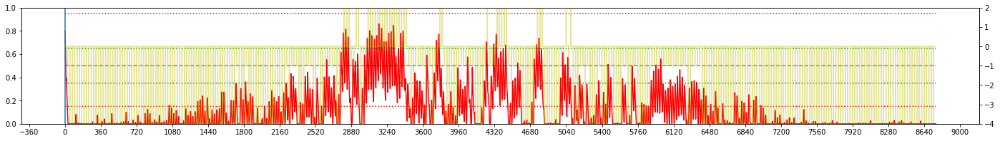


Iteration 14:  WAKKANAI, 2002 
EPSILON = 5.004e-01
LR = 9.820e-05
Average Terminal Reward  = -4.012
Day Violations           =    333
Battery Limit Violations =   4170
Action MEAN              =  5.017
Action STD DEV           =  1.685


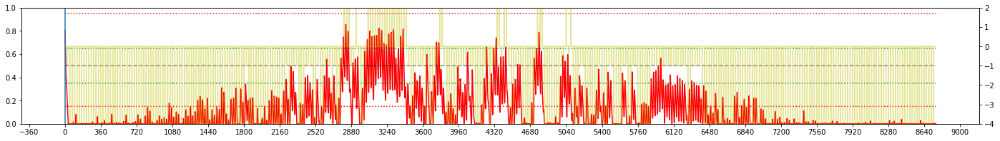


Iteration 15:  WAKKANAI, 2001 
EPSILON = 5.005e-01
LR = 9.870e-05
Average Terminal Reward  = -4.119
Day Violations           =    334
Battery Limit Violations =   4420
Action MEAN              =  5.017
Action STD DEV           =  1.703


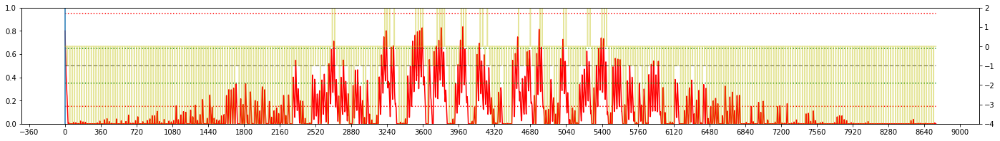


Iteration 16:  WAKKANAI, 2003 
EPSILON = 5.006e-01
LR = 9.907e-05
Average Terminal Reward  = -3.873
Day Violations           =    332
Battery Limit Violations =   3844
Action MEAN              =  5.027
Action STD DEV           =  1.705


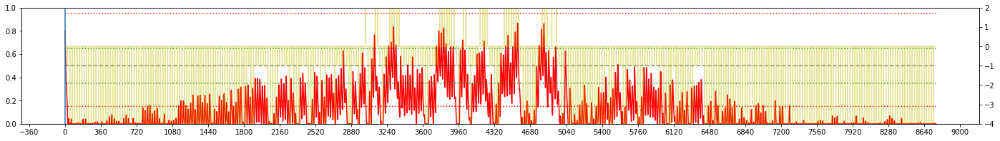


Iteration 17:  WAKKANAI, 2000 
EPSILON = 5.007e-01
LR = 9.933e-05
Average Terminal Reward  = -4.324
Day Violations           =    345
Battery Limit Violations =   4385
Action MEAN              =  4.925
Action STD DEV           =  1.601


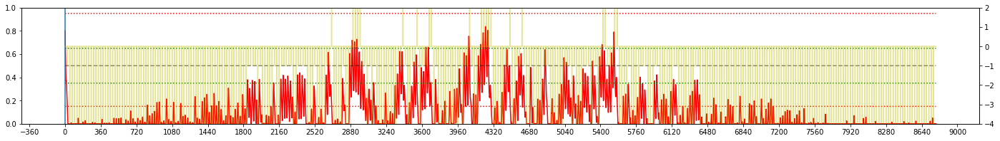


Iteration 18:  WAKKANAI, 2003 
EPSILON = 5.008e-01
LR = 9.952e-05
Average Terminal Reward  = -3.829
Day Violations           =    331
Battery Limit Violations =   3832
Action MEAN              =  5.019
Action STD DEV           =  1.718


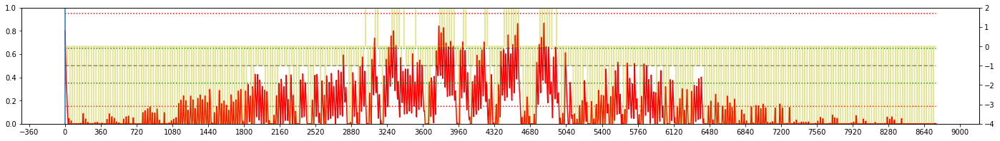


Iteration 19:  WAKKANAI, 2009 
EPSILON = 5.010e-01
LR = 9.966e-05
Average Terminal Reward  = -4.101
Day Violations           =    333
Battery Limit Violations =   4296
Action MEAN              =  4.952
Action STD DEV           =  1.669


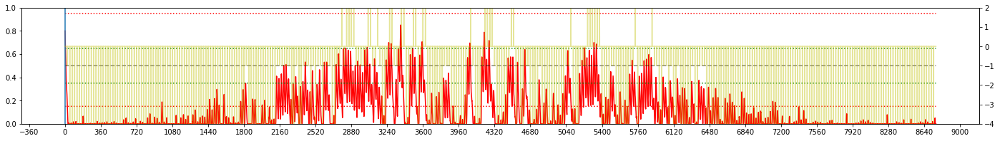


Iteration 20:  WAKKANAI, 2004 
EPSILON = 5.012e-01
LR = 9.975e-05
Average Terminal Reward  = -4.023
Day Violations           =    334
Battery Limit Violations =   4163
Action MEAN              =  5.001
Action STD DEV           =  1.694


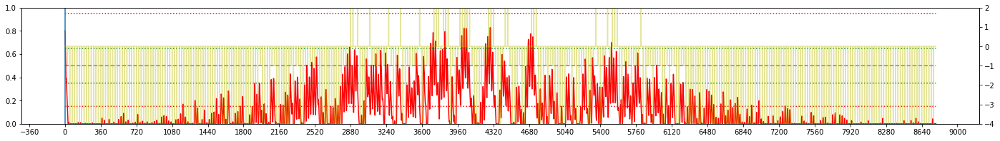


Iteration 21:  WAKKANAI, 2000 
EPSILON = 5.015e-01
LR = 9.982e-05
Average Terminal Reward  = -4.327
Day Violations           =    341
Battery Limit Violations =   4400
Action MEAN              =  4.948
Action STD DEV           =  1.599


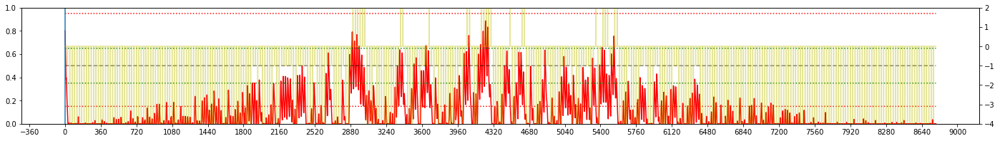


Iteration 22:  WAKKANAI, 2003 
EPSILON = 5.018e-01
LR = 9.987e-05
Average Terminal Reward  = -3.833
Day Violations           =    332
Battery Limit Violations =   3810
Action MEAN              =  5.024
Action STD DEV           =  1.711


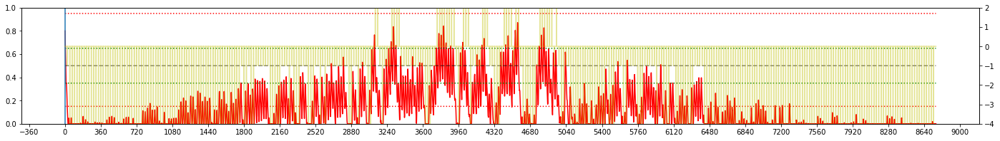


Iteration 23:  WAKKANAI, 2002 
EPSILON = 5.022e-01
LR = 9.991e-05
Average Terminal Reward  = -4.013
Day Violations           =    333
Battery Limit Violations =   4227
Action MEAN              =  5.029
Action STD DEV           =  1.683


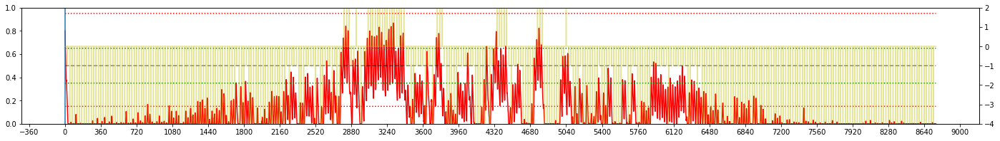


Iteration 24:  WAKKANAI, 2005 
EPSILON = 5.027e-01
LR = 9.993e-05
Average Terminal Reward  = -3.886
Day Violations           =    322
Battery Limit Violations =   4085
Action MEAN              =  5.038
Action STD DEV           =  1.751


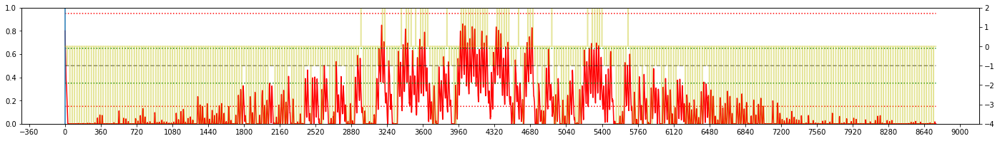


Iteration 25:  WAKKANAI, 2005 
EPSILON = 5.033e-01
LR = 9.995e-05
Average Terminal Reward  = -3.869
Day Violations           =    322
Battery Limit Violations =   4110
Action MEAN              =  5.050
Action STD DEV           =  1.757


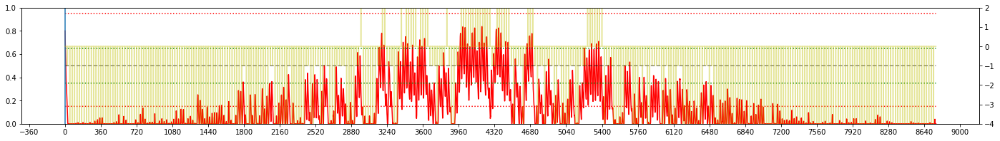


Iteration 26:  WAKKANAI, 2005 
EPSILON = 5.041e-01
LR = 9.997e-05
Average Terminal Reward  = -3.872
Day Violations           =    323
Battery Limit Violations =   4094
Action MEAN              =  5.043
Action STD DEV           =  1.752


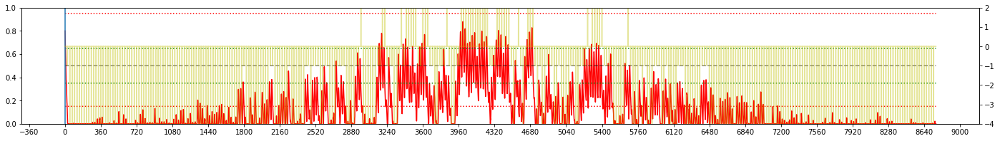


Iteration 27:  WAKKANAI, 2008 
EPSILON = 5.050e-01
LR = 9.998e-05
Average Terminal Reward  = -4.103
Day Violations           =    331
Battery Limit Violations =   4229
Action MEAN              =  5.006
Action STD DEV           =  1.668


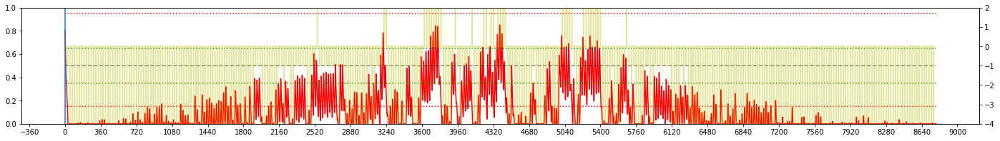


Iteration 28:  WAKKANAI, 2009 
EPSILON = 5.061e-01
LR = 9.998e-05
Average Terminal Reward  = -4.137
Day Violations           =    339
Battery Limit Violations =   4303
Action MEAN              =  4.934
Action STD DEV           =  1.647


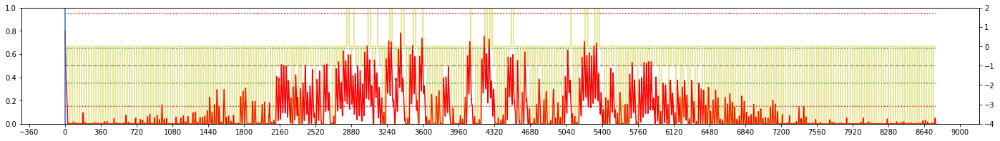


Iteration 29:  WAKKANAI, 2003 
EPSILON = 5.074e-01
LR = 9.999e-05
Average Terminal Reward  = -3.836
Day Violations           =    330
Battery Limit Violations =   3858
Action MEAN              =  5.031
Action STD DEV           =  1.728


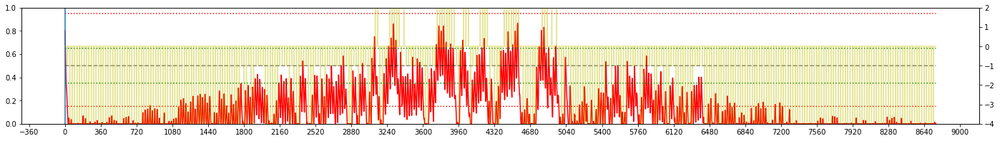


Iteration 30:  WAKKANAI, 2009 
EPSILON = 5.090e-01
LR = 9.999e-05
Average Terminal Reward  = -4.128
Day Violations           =    336
Battery Limit Violations =   4281
Action MEAN              =  4.957
Action STD DEV           =  1.650


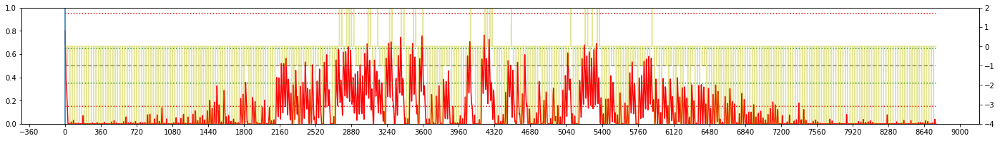


Iteration 31:  WAKKANAI, 2005 
EPSILON = 5.109e-01
LR = 9.999e-05
Average Terminal Reward  = -3.916
Day Violations           =    325
Battery Limit Violations =   4261
Action MEAN              =  5.468
Action STD DEV           =  2.755


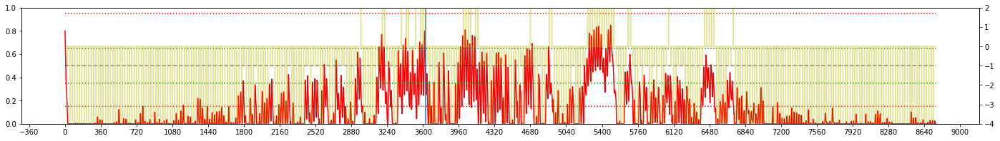


Iteration 32:  WAKKANAI, 2006 
EPSILON = 5.133e-01
LR = 1.000e-04
Average Terminal Reward  = -3.446
Day Violations           =    287
Battery Limit Violations =   3822
Action MEAN              =  5.263
Action STD DEV           =  2.863


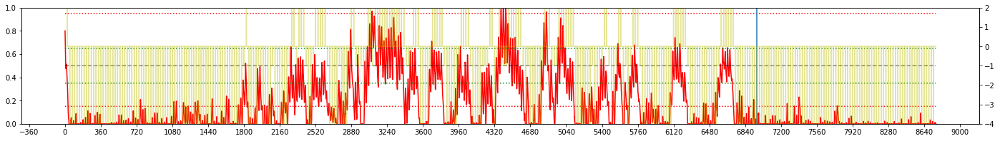


Iteration 33:  WAKKANAI, 2008 
EPSILON = 5.161e-01
LR = 1.000e-04
Average Terminal Reward  = -2.853
Day Violations           =    273
Battery Limit Violations =   2827
Action MEAN              =  4.307
Action STD DEV           =  2.735


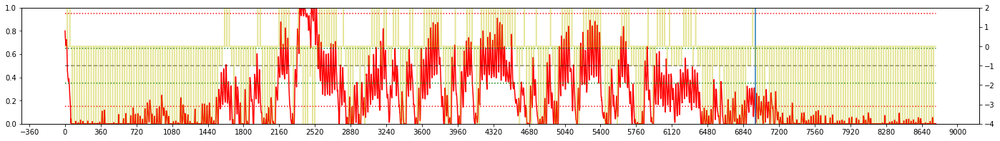


Iteration 34:  WAKKANAI, 2007 
EPSILON = 5.196e-01
LR = 1.000e-04
Average Terminal Reward  = -2.287
Day Violations           =    247
Battery Limit Violations =   2573
Action MEAN              =  4.319
Action STD DEV           =  2.914


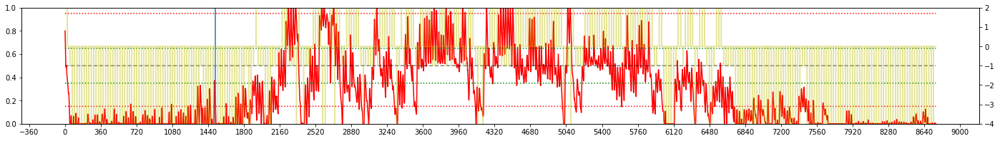


Iteration 35:  WAKKANAI, 2002 
EPSILON = 5.237e-01
LR = 1.000e-04
Average Terminal Reward  = -1.883
Day Violations           =    211
Battery Limit Violations =   2631
Action MEAN              =  4.817
Action STD DEV           =  3.044


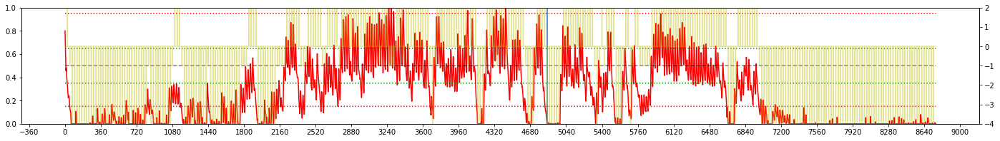


Iteration 36:  WAKKANAI, 2007 
EPSILON = 5.287e-01
LR = 1.000e-04
Average Terminal Reward  = -0.895
Day Violations           =    157
Battery Limit Violations =   1821
Action MEAN              =  4.044
Action STD DEV           =  2.891


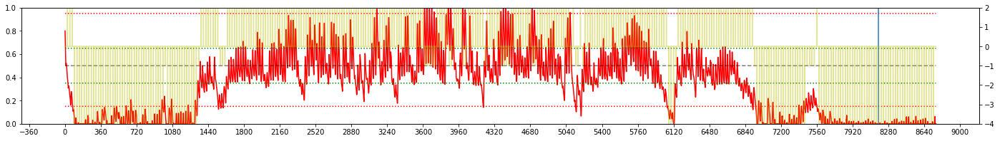


Iteration 37:  WAKKANAI, 2000 
EPSILON = 5.346e-01
LR = 1.000e-04
Average Terminal Reward  =  0.219
Day Violations           =     92
Battery Limit Violations =   1317
Action MEAN              =  3.366
Action STD DEV           =  2.513


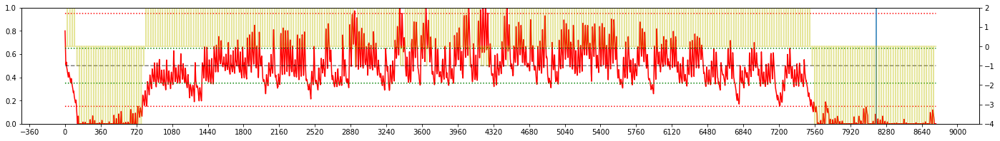


Iteration 38:  WAKKANAI, 2007 
EPSILON = 5.416e-01
LR = 1.000e-04
Average Terminal Reward  =  0.088
Day Violations           =    109
Battery Limit Violations =   1358
Action MEAN              =  3.872
Action STD DEV           =  2.809


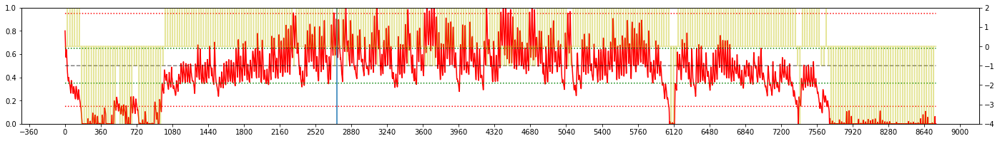


Iteration 39:  WAKKANAI, 2009 
EPSILON = 5.499e-01
LR = 1.000e-04
Average Terminal Reward  = -0.351
Day Violations           =    119
Battery Limit Violations =   1741
Action MEAN              =  4.011
Action STD DEV           =  3.016


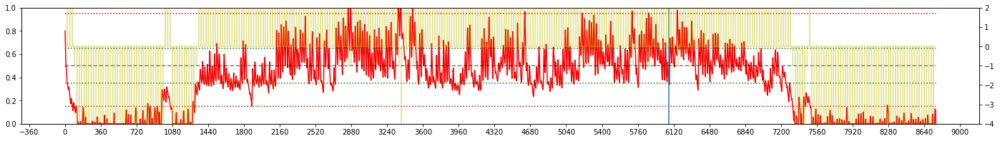


Iteration 40:  WAKKANAI, 2005 
EPSILON = 5.596e-01
LR = 1.000e-04
Average Terminal Reward  =  0.013
Day Violations           =    109
Battery Limit Violations =   1367
Action MEAN              =  3.955
Action STD DEV           =  3.055


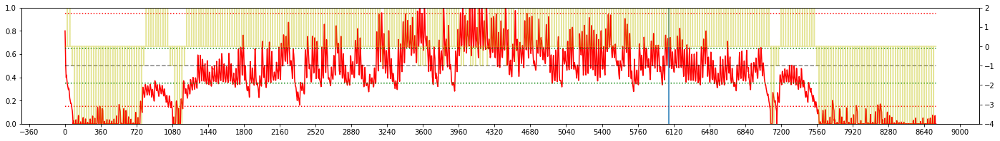


Iteration 41:  WAKKANAI, 2008 
EPSILON = 5.709e-01
LR = 1.000e-04
Average Terminal Reward  =  0.362
Day Violations           =     91
Battery Limit Violations =   1079
Action MEAN              =  3.398
Action STD DEV           =  2.724


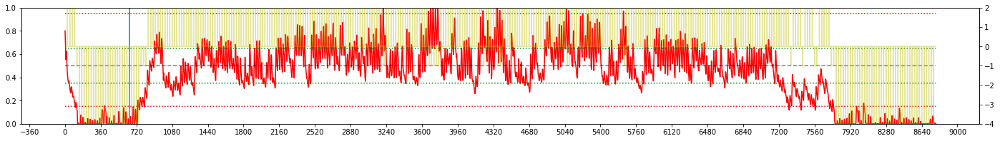


Iteration 42:  WAKKANAI, 2003 
EPSILON = 5.840e-01
LR = 1.000e-04
Average Terminal Reward  =  0.289
Day Violations           =     96
Battery Limit Violations =   1069
Action MEAN              =  3.904
Action STD DEV           =  3.009


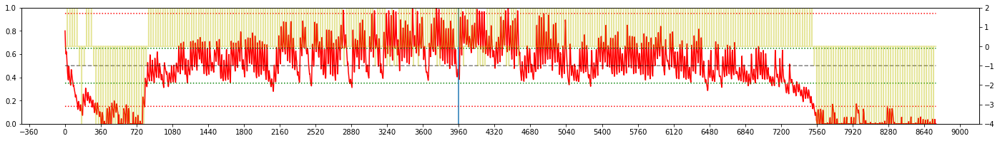


Iteration 43:  WAKKANAI, 2005 
EPSILON = 5.989e-01
LR = 1.000e-04
Average Terminal Reward  =  0.499
Day Violations           =     77
Battery Limit Violations =   1030
Action MEAN              =  3.723
Action STD DEV           =  2.951


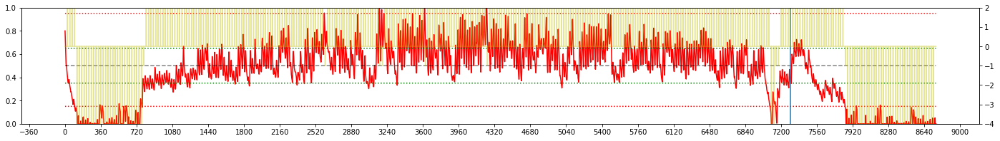


Iteration 44:  WAKKANAI, 2008 
EPSILON = 6.157e-01
LR = 1.000e-04
Average Terminal Reward  =  0.487
Day Violations           =     80
Battery Limit Violations =   1187
Action MEAN              =  3.792
Action STD DEV           =  3.032


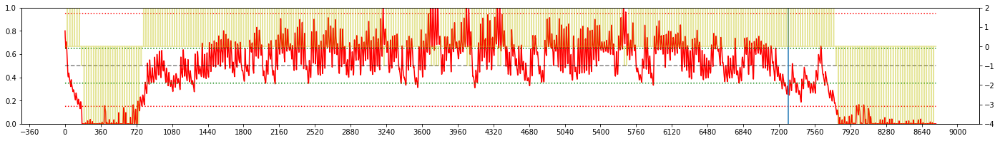


Iteration 45:  WAKKANAI, 2000 
EPSILON = 6.345e-01
LR = 1.000e-04
Average Terminal Reward  =  0.515
Day Violations           =     81
Battery Limit Violations =   1098
Action MEAN              =  3.574
Action STD DEV           =  2.892


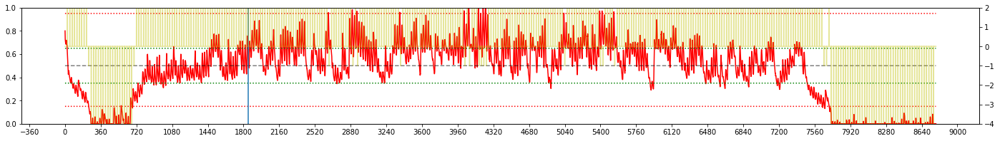


Iteration 46:  WAKKANAI, 2001 
EPSILON = 6.550e-01
LR = 1.000e-04
Average Terminal Reward  =  0.140
Day Violations           =    109
Battery Limit Violations =   1138
Action MEAN              =  3.750
Action STD DEV           =  3.089


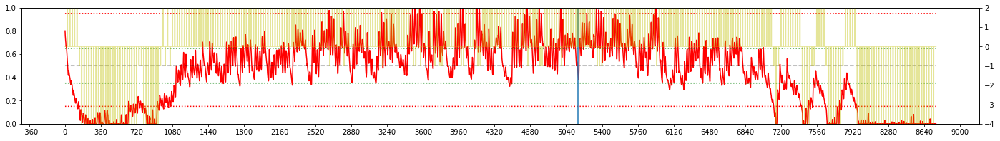


Iteration 47:  WAKKANAI, 2007 
EPSILON = 6.772e-01
LR = 1.000e-04
Average Terminal Reward  =  0.714
Day Violations           =     71
Battery Limit Violations =    954
Action MEAN              =  3.651
Action STD DEV           =  2.962


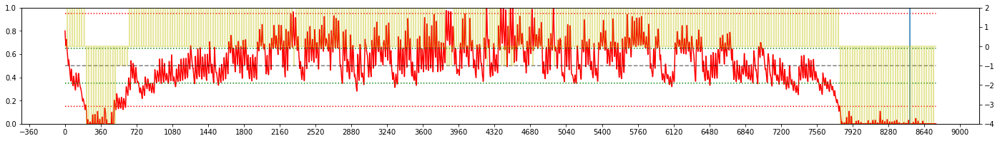


Iteration 48:  WAKKANAI, 2006 
EPSILON = 7.007e-01
LR = 1.000e-04
Average Terminal Reward  =  0.521
Day Violations           =     79
Battery Limit Violations =   1163
Action MEAN              =  3.813
Action STD DEV           =  3.012


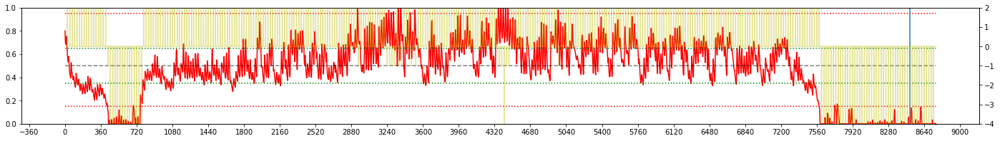


Iteration 49:  WAKKANAI, 2009 
EPSILON = 7.251e-01
LR = 1.000e-04
Average Terminal Reward  =  0.071
Day Violations           =    107
Battery Limit Violations =   1347
Action MEAN              =  3.733
Action STD DEV           =  2.951


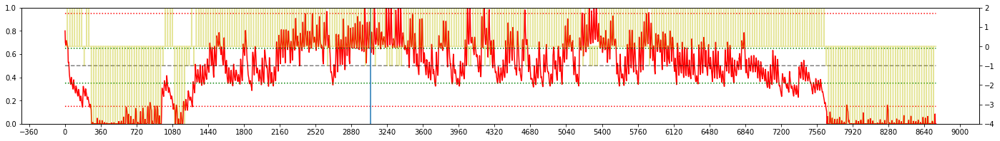


Iteration 50:  WAKKANAI, 2007 
EPSILON = 7.500e-01
LR = 1.000e-04
Average Terminal Reward  =  0.609
Day Violations           =     73
Battery Limit Violations =   1173
Action MEAN              =  3.985
Action STD DEV           =  3.169


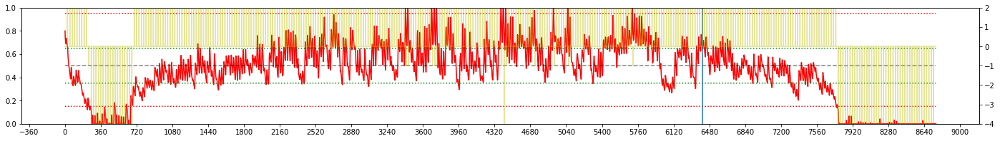


Iteration 51:  WAKKANAI, 2008 
EPSILON = 7.749e-01
LR = 8.750e-05
Average Terminal Reward  =  0.435
Day Violations           =     79
Battery Limit Violations =   1392
Action MEAN              =  4.037
Action STD DEV           =  3.166


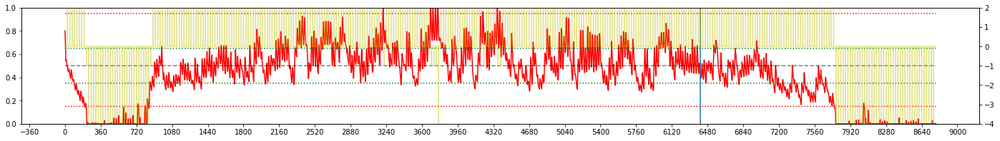


Iteration 52:  WAKKANAI, 2001 
EPSILON = 7.993e-01
LR = 7.681e-05
Average Terminal Reward  =  0.211
Day Violations           =     90
Battery Limit Violations =   1343
Action MEAN              =  3.753
Action STD DEV           =  3.157


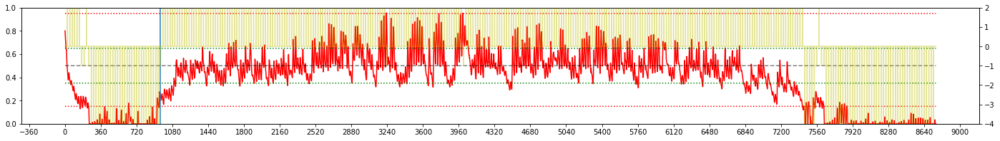


Iteration 53:  WAKKANAI, 2001 
EPSILON = 8.228e-01
LR = 6.767e-05
Average Terminal Reward  =  0.360
Day Violations           =     81
Battery Limit Violations =   1315
Action MEAN              =  3.868
Action STD DEV           =  3.292


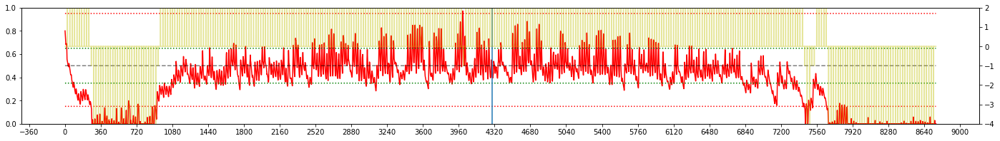


Iteration 54:  WAKKANAI, 2002 
EPSILON = 8.450e-01
LR = 5.986e-05
Average Terminal Reward  =  0.609
Day Violations           =     67
Battery Limit Violations =   1179
Action MEAN              =  3.865
Action STD DEV           =  3.244


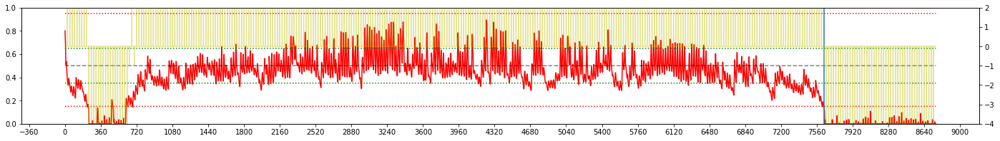


Iteration 55:  WAKKANAI, 2004 
EPSILON = 8.655e-01
LR = 5.318e-05
Average Terminal Reward  =  0.939
Day Violations           =     52
Battery Limit Violations =    865
Action MEAN              =  3.558
Action STD DEV           =  3.123


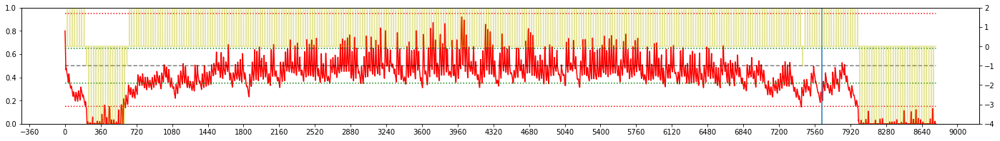


Iteration 56:  WAKKANAI, 2007 
EPSILON = 8.843e-01
LR = 4.747e-05
Average Terminal Reward  =  0.846
Day Violations           =     56
Battery Limit Violations =    919
Action MEAN              =  3.654
Action STD DEV           =  3.248


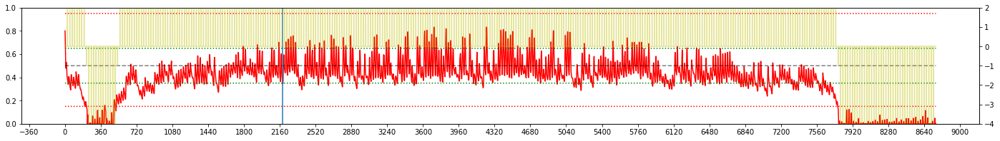


Iteration 57:  WAKKANAI, 2008 
EPSILON = 9.011e-01
LR = 4.259e-05
Average Terminal Reward  =  0.593
Day Violations           =     69
Battery Limit Violations =   1120
Action MEAN              =  3.796
Action STD DEV           =  3.242


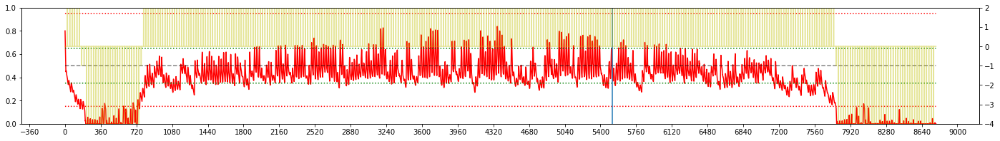


Iteration 58:  WAKKANAI, 2006 
EPSILON = 9.160e-01
LR = 3.841e-05
Average Terminal Reward  =  0.731
Day Violations           =     62
Battery Limit Violations =    989
Action MEAN              =  3.755
Action STD DEV           =  3.252


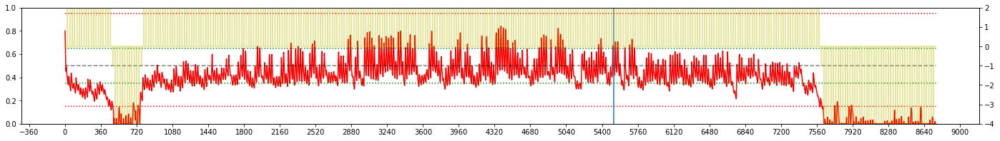


Iteration 59:  WAKKANAI, 2006 
EPSILON = 9.291e-01
LR = 3.484e-05
Average Terminal Reward  =  0.737
Day Violations           =     61
Battery Limit Violations =   1035
Action MEAN              =  3.693
Action STD DEV           =  3.180


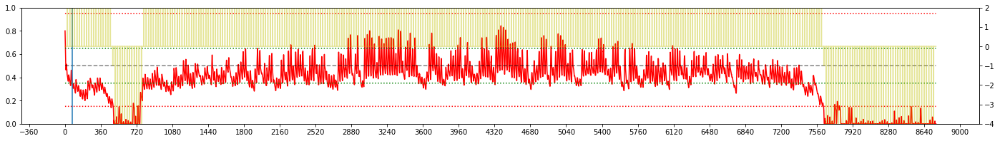


Iteration 60:  WAKKANAI, 2005 
EPSILON = 9.404e-01
LR = 3.179e-05
Average Terminal Reward  =  0.745
Day Violations           =     62
Battery Limit Violations =    957
Action MEAN              =  3.684
Action STD DEV           =  3.200


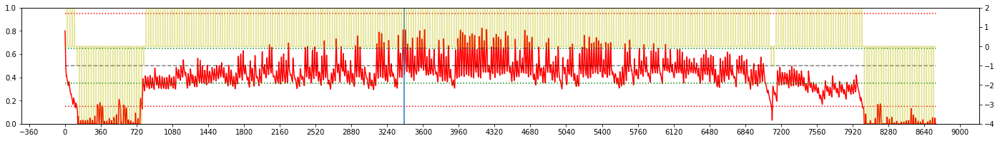


Iteration 61:  WAKKANAI, 2009 
EPSILON = 9.501e-01
LR = 2.918e-05
Average Terminal Reward  =  0.585
Day Violations           =     70
Battery Limit Violations =   1032
Action MEAN              =  3.628
Action STD DEV           =  3.305


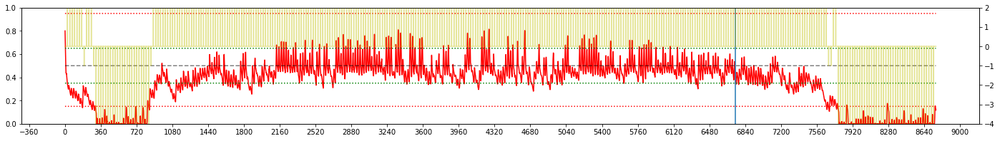


Iteration 62:  WAKKANAI, 2006 
EPSILON = 9.584e-01
LR = 2.695e-05
Average Terminal Reward  =  0.978
Day Violations           =     49
Battery Limit Violations =    843
Action MEAN              =  3.470
Action STD DEV           =  3.162


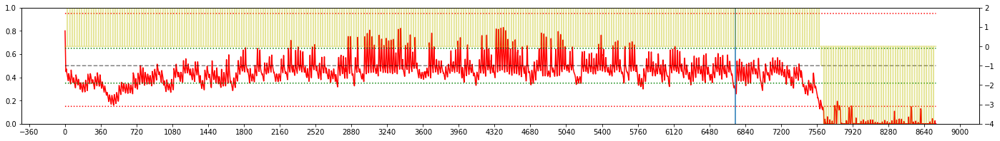


Iteration 63:  WAKKANAI, 2003 
EPSILON = 9.654e-01
LR = 2.504e-05
Average Terminal Reward  =  1.244
Day Violations           =     39
Battery Limit Violations =    541
Action MEAN              =  3.645
Action STD DEV           =  3.389


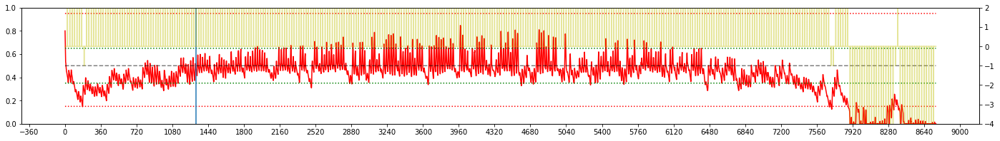


Iteration 64:  WAKKANAI, 2004 
EPSILON = 9.713e-01
LR = 2.341e-05
Average Terminal Reward  =  0.997
Day Violations           =     49
Battery Limit Violations =    850
Action MEAN              =  3.795
Action STD DEV           =  3.489


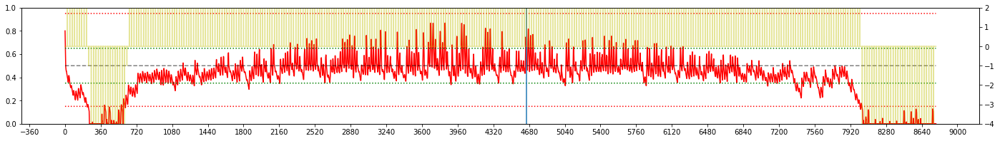


Iteration 65:  WAKKANAI, 2001 
EPSILON = 9.763e-01
LR = 2.202e-05
Average Terminal Reward  =  0.863
Day Violations           =     59
Battery Limit Violations =    846
Action MEAN              =  3.493
Action STD DEV           =  3.334


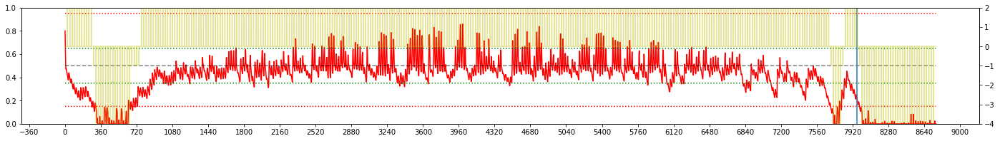


Iteration 66:  WAKKANAI, 2000 
EPSILON = 9.804e-01
LR = 2.082e-05
Average Terminal Reward  =  0.835
Day Violations           =     58
Battery Limit Violations =    874
Action MEAN              =  3.460
Action STD DEV           =  3.269


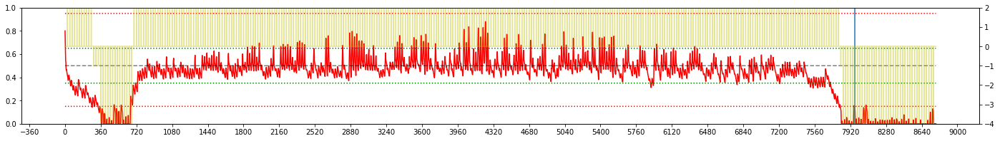


Iteration 67:  WAKKANAI, 2003 
EPSILON = 9.839e-01
LR = 1.980e-05
Average Terminal Reward  =  1.277
Day Violations           =     36
Battery Limit Violations =    540
Action MEAN              =  3.385
Action STD DEV           =  3.234


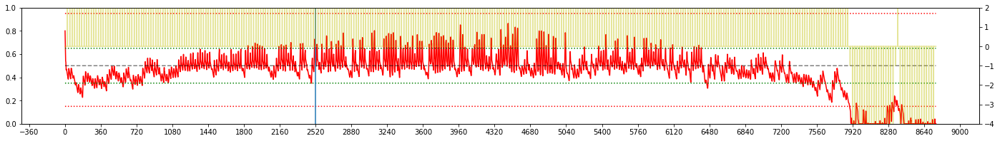


Iteration 68:  WAKKANAI, 2003 
EPSILON = 9.867e-01
LR = 1.893e-05
Average Terminal Reward  =  1.553
Day Violations           =     26
Battery Limit Violations =    302
Action MEAN              =  3.489
Action STD DEV           =  3.420


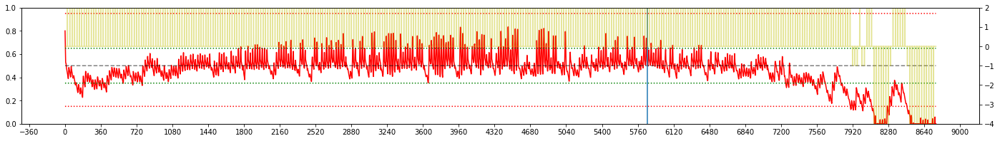


Iteration 69:  WAKKANAI, 2000 
EPSILON = 9.891e-01
LR = 1.819e-05
Average Terminal Reward  =  0.839
Day Violations           =     57
Battery Limit Violations =    813
Action MEAN              =  3.409
Action STD DEV           =  3.304


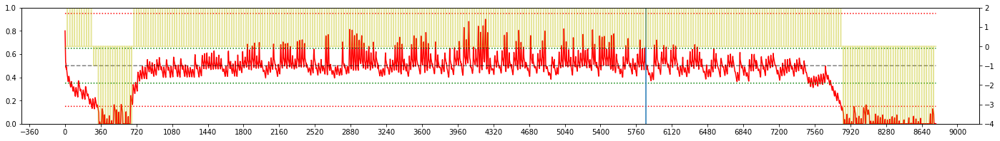


Iteration 70:  WAKKANAI, 2009 
EPSILON = 9.910e-01
LR = 1.755e-05
Average Terminal Reward  =  0.880
Day Violations           =     58
Battery Limit Violations =    712
Action MEAN              =  3.344
Action STD DEV           =  3.298


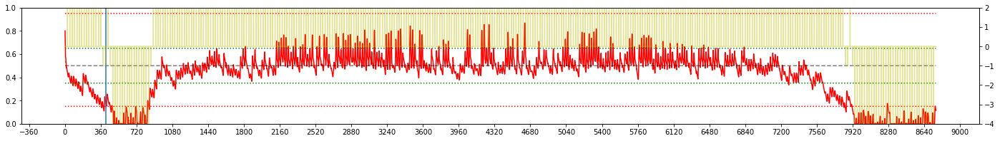


Iteration 71:  WAKKANAI, 2007 
EPSILON = 9.926e-01
LR = 1.701e-05
Average Terminal Reward  =  1.177
Day Violations           =     39
Battery Limit Violations =    686
Action MEAN              =  3.470
Action STD DEV           =  3.286


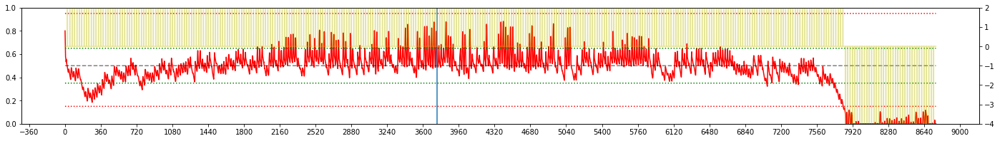


Iteration 72:  WAKKANAI, 2004 
EPSILON = 9.939e-01
LR = 1.654e-05
Average Terminal Reward  =  1.079
Day Violations           =     46
Battery Limit Violations =    733
Action MEAN              =  3.422
Action STD DEV           =  3.324


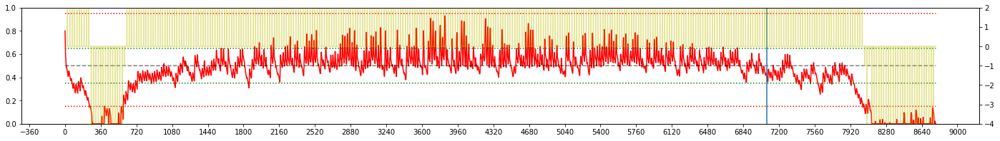


Iteration 73:  WAKKANAI, 2003 
EPSILON = 9.950e-01
LR = 1.614e-05
Average Terminal Reward  =  1.569
Day Violations           =     25
Battery Limit Violations =    161
Action MEAN              =  3.243
Action STD DEV           =  3.339


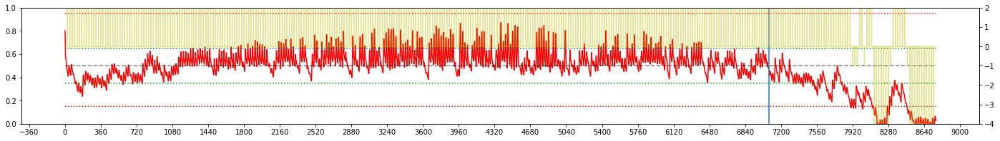


Iteration 74:  WAKKANAI, 2005 
EPSILON = 9.959e-01
LR = 1.580e-05
Average Terminal Reward  =  1.471
Day Violations           =     32
Battery Limit Violations =    232
Action MEAN              =  3.273
Action STD DEV           =  3.329


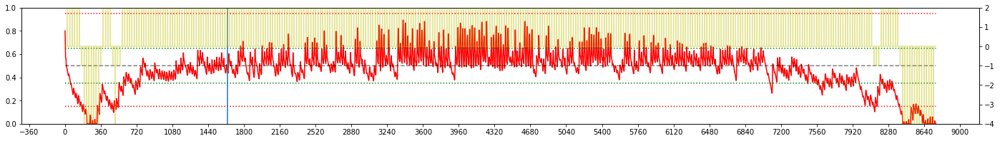


Iteration 75:  WAKKANAI, 2000 
EPSILON = 9.967e-01
LR = 1.551e-05
Average Terminal Reward  =  1.052
Day Violations           =     49
Battery Limit Violations =    504
Action MEAN              =  3.131
Action STD DEV           =  3.142


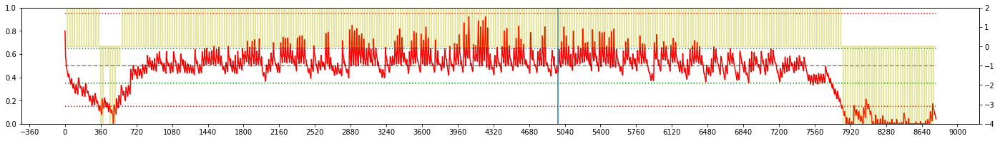


Iteration 76:  WAKKANAI, 2006 
EPSILON = 9.973e-01
LR = 1.526e-05
Average Terminal Reward  =  1.344
Day Violations           =     35
Battery Limit Violations =    283
Action MEAN              =  3.008
Action STD DEV           =  3.110


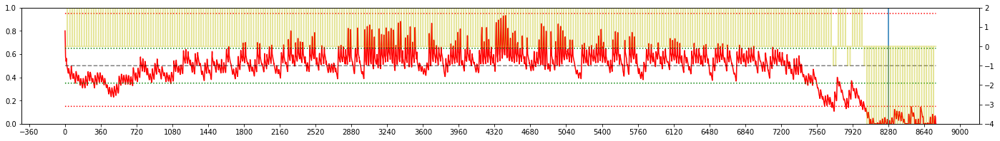


Iteration 77:  WAKKANAI, 2001 
EPSILON = 9.978e-01
LR = 1.505e-05
Average Terminal Reward  =  1.302
Day Violations           =     35
Battery Limit Violations =    314
Action MEAN              =  3.029
Action STD DEV           =  3.179


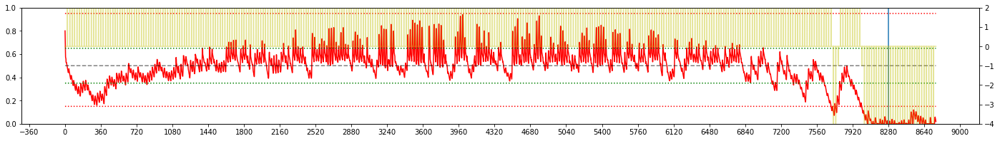


Iteration 78:  WAKKANAI, 2007 
EPSILON = 9.982e-01
LR = 1.487e-05
Average Terminal Reward  =  1.175
Day Violations           =     39
Battery Limit Violations =    753
Action MEAN              =  3.706
Action STD DEV           =  3.432


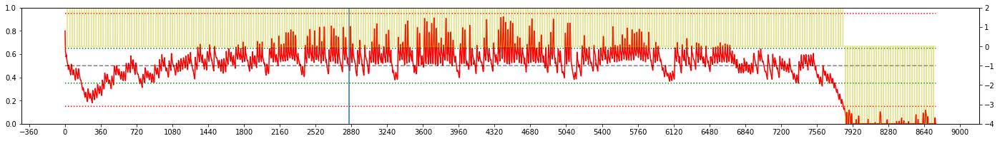


Iteration 79:  WAKKANAI, 2004 
EPSILON = 9.985e-01
LR = 1.471e-05
Average Terminal Reward  =  1.102
Day Violations           =     47
Battery Limit Violations =    594
Action MEAN              =  3.368
Action STD DEV           =  3.319


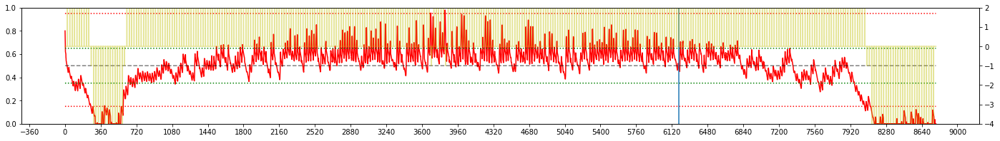


Iteration 80:  WAKKANAI, 2005 
EPSILON = 9.988e-01
LR = 1.458e-05
Average Terminal Reward  =  1.462
Day Violations           =     34
Battery Limit Violations =    194
Action MEAN              =  3.258
Action STD DEV           =  3.342


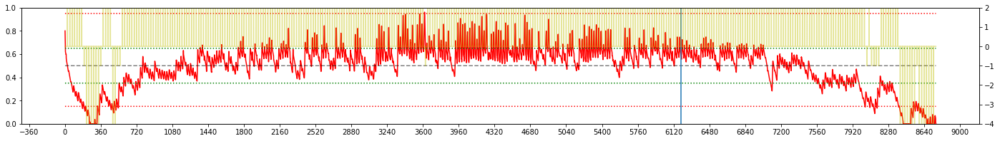


Iteration 81:  WAKKANAI, 2005 
EPSILON = 9.990e-01
LR = 1.446e-05
Average Terminal Reward  =  1.539
Day Violations           =     31
Battery Limit Violations =    108
Action MEAN              =  3.129
Action STD DEV           =  3.257


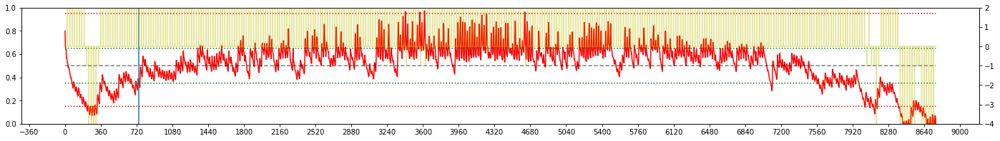


Iteration 82:  WAKKANAI, 2001 
EPSILON = 9.992e-01
LR = 1.437e-05
Average Terminal Reward  =  1.275
Day Violations           =     38
Battery Limit Violations =    413
Action MEAN              =  3.111
Action STD DEV           =  3.253


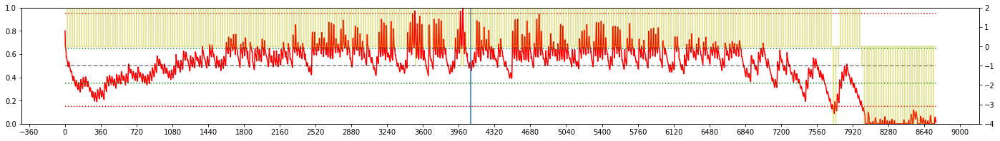


Iteration 83:  WAKKANAI, 2006 
EPSILON = 9.993e-01
LR = 1.428e-05
Average Terminal Reward  =  1.325
Day Violations           =     37
Battery Limit Violations =    390
Action MEAN              =  3.226
Action STD DEV           =  3.303


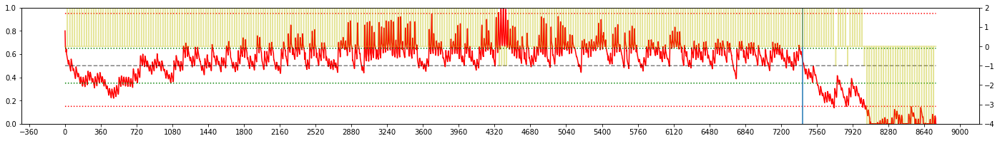


Iteration 84:  WAKKANAI, 2009 
EPSILON = 9.994e-01
LR = 1.421e-05
Average Terminal Reward  =  1.093
Day Violations           =     53
Battery Limit Violations =    388
Action MEAN              =  3.013
Action STD DEV           =  3.199


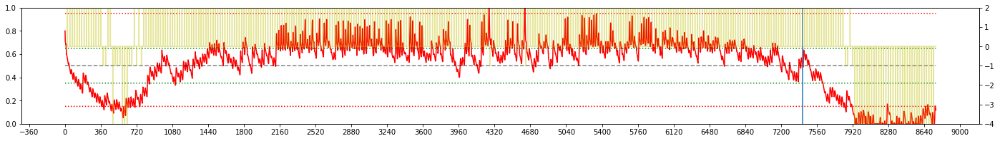


Iteration 85:  WAKKANAI, 2003 
EPSILON = 9.995e-01
LR = 1.415e-05
Average Terminal Reward  =  1.511
Day Violations           =     32
Battery Limit Violations =    172
Action MEAN              =  3.237
Action STD DEV           =  3.410


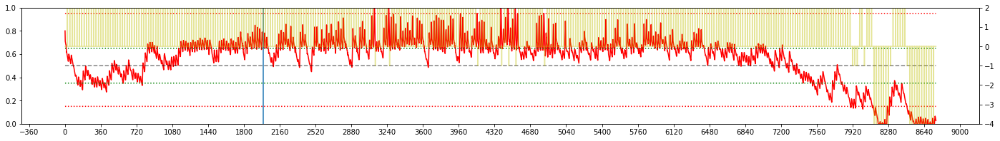


Iteration 86:  WAKKANAI, 2003 
EPSILON = 9.996e-01
LR = 1.410e-05
Average Terminal Reward  =  1.513
Day Violations           =     33
Battery Limit Violations =    187
Action MEAN              =  3.250
Action STD DEV           =  3.418


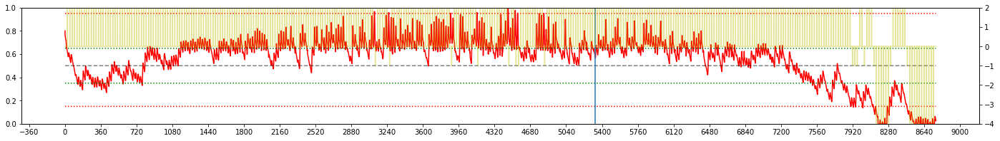


Iteration 87:  WAKKANAI, 2000 
EPSILON = 9.997e-01
LR = 1.406e-05
Average Terminal Reward  =  1.056
Day Violations           =     55
Battery Limit Violations =    491
Action MEAN              =  2.984
Action STD DEV           =  3.171


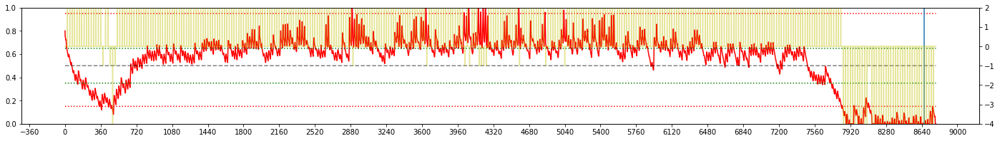


Iteration 88:  WAKKANAI, 2005 
EPSILON = 9.997e-01
LR = 1.402e-05
Average Terminal Reward  =  1.406
Day Violations           =     53
Battery Limit Violations =    196
Action MEAN              =  3.137
Action STD DEV           =  3.409


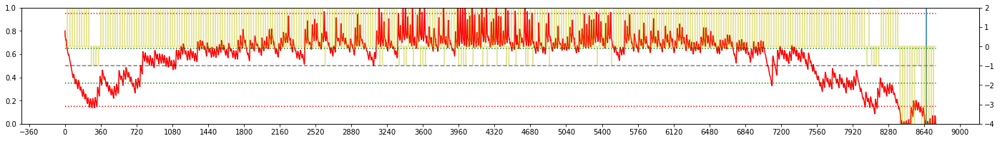


Iteration 89:  WAKKANAI, 2009 
EPSILON = 9.998e-01
LR = 1.398e-05
Average Terminal Reward  =  0.823
Day Violations           =     70
Battery Limit Violations =    695
Action MEAN              =  3.450
Action STD DEV           =  3.540


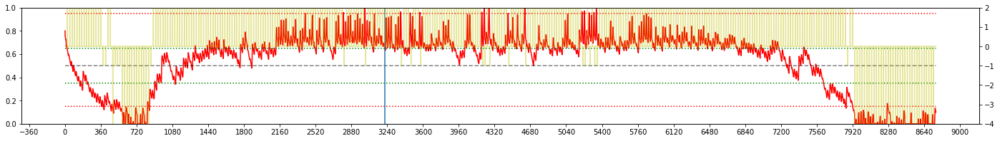


Iteration 90:  WAKKANAI, 2007 
EPSILON = 9.998e-01
LR = 1.396e-05
Average Terminal Reward  =  0.948
Day Violations           =     67
Battery Limit Violations =    722
Action MEAN              =  3.724
Action STD DEV           =  3.722


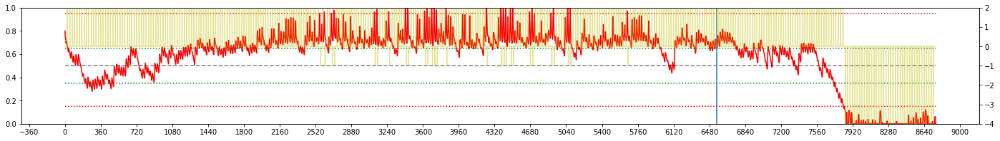


Iteration 91:  WAKKANAI, 2005 
EPSILON = 9.999e-01
LR = 1.393e-05
Average Terminal Reward  =  1.301
Day Violations           =     63
Battery Limit Violations =    225
Action MEAN              =  3.100
Action STD DEV           =  3.401


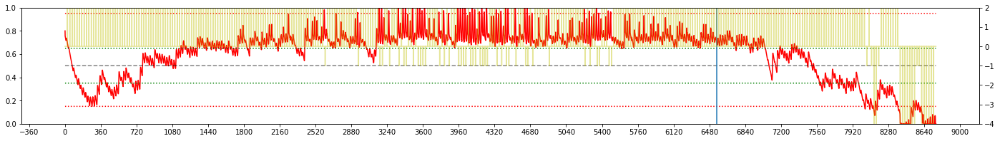


Iteration 92:  WAKKANAI, 2004 
EPSILON = 9.999e-01
LR = 1.391e-05
Average Terminal Reward  =  0.820
Day Violations           =     77
Battery Limit Violations =    675
Action MEAN              =  3.520
Action STD DEV           =  3.607


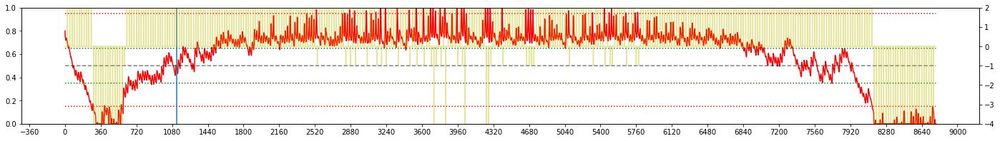


Iteration 93:  WAKKANAI, 2001 
EPSILON = 9.999e-01
LR = 1.390e-05
Average Terminal Reward  =  0.926
Day Violations           =     79
Battery Limit Violations =    609
Action MEAN              =  3.295
Action STD DEV           =  3.510


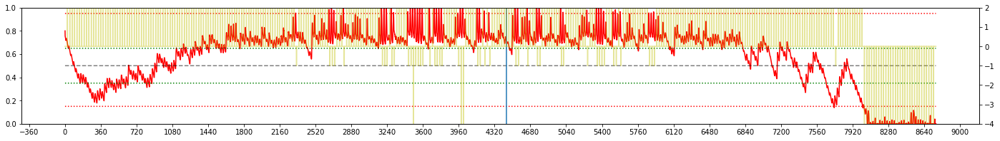


Iteration 94:  WAKKANAI, 2000 
EPSILON = 9.999e-01
LR = 1.388e-05
Average Terminal Reward  =  0.844
Day Violations           =     77
Battery Limit Violations =    642
Action MEAN              =  3.110
Action STD DEV           =  3.360


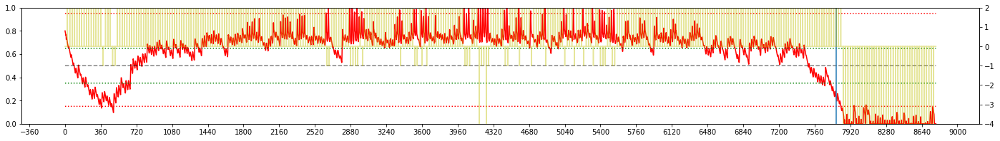


Iteration 95:  WAKKANAI, 2008 
EPSILON = 9.999e-01
LR = 1.387e-05
Average Terminal Reward  =  0.592
Day Violations           =     97
Battery Limit Violations =    581
Action MEAN              =  3.286
Action STD DEV           =  3.466


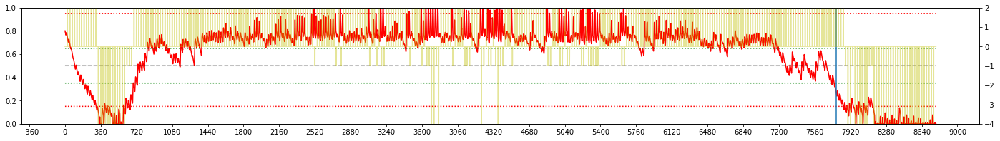


Iteration 96:  WAKKANAI, 2005 
EPSILON = 9.999e-01
LR = 1.386e-05
Average Terminal Reward  =  1.000
Day Violations           =     87
Battery Limit Violations =    451
Action MEAN              =  3.360
Action STD DEV           =  3.547


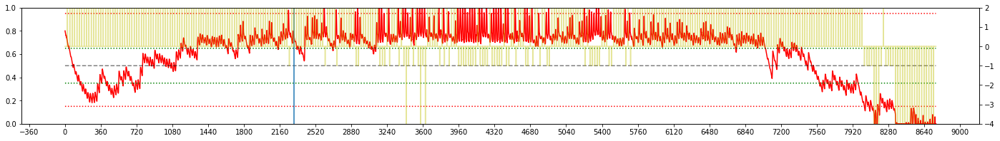


Iteration 97:  WAKKANAI, 2006 
EPSILON = 1.000e+00
LR = 1.385e-05
Average Terminal Reward  =  0.987
Day Violations           =     72
Battery Limit Violations =    611
Action MEAN              =  3.376
Action STD DEV           =  3.503


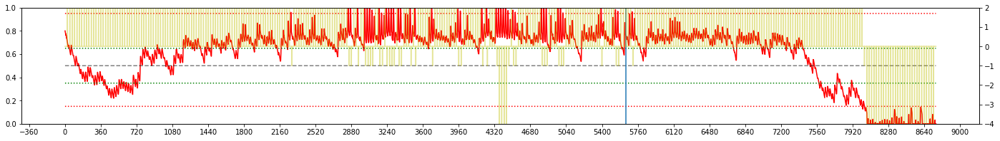


Iteration 98:  WAKKANAI, 2002 
EPSILON = 1.000e+00
LR = 1.384e-05
Average Terminal Reward  =  0.655
Day Violations           =     93
Battery Limit Violations =    853
Action MEAN              =  3.465
Action STD DEV           =  3.474


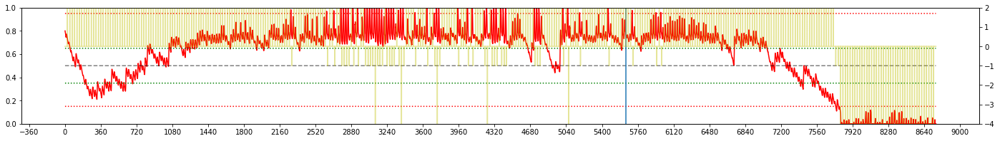


Iteration 99:  WAKKANAI, 2000 
EPSILON = 1.000e+00
LR = 1.383e-05
Average Terminal Reward  =  0.610
Day Violations           =     92
Battery Limit Violations =    858
Action MEAN              =  3.533
Action STD DEV           =  3.665


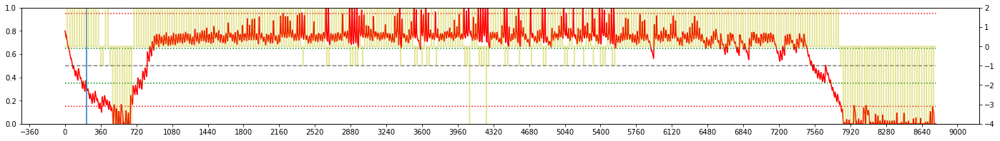

In [17]:
#TRAIN 
dqn = DQN()
# for recording weights
oldfc1 = dqn.eval_net.fc1.weight.data.cpu().numpy().flatten()
old2fc1 = oldfc1

# oldfc2 = dqn.eval_net.fc2.weight.data.cpu().numpy().flatten()
# old2fc2 = oldfc2

# oldfc3 = dqn.eval_net.fc3.weight.data.cpu().numpy().flatten()
# old2fc3 = oldfc3

oldout = dqn.eval_net.fc_out.weight.data.cpu().numpy().flatten()
old2out = oldout
########################################

change_hr = 0 #when dqn target_net is updated by eval_net
avg_reward_rec = [] #record the yearly average rewards over the entire duration of training
batt_violation_rec = []
day_violation_rec = []

print('Device: ', dqn.device)
#TRAINING STARTS
tic = datetime.now()

e_rec = []
lr_rec = []
for iteration in range(NO_OF_ITERATIONS):
    # EPSILON SCHEDULING
    e_slope = 5
    e_start = 0.5
    e_inflection_point = 50
    EPSILON = e_start + (1-e_start)/(1 + np.exp(-(iteration-e_inflection_point)/e_slope))

    # LR SCEHDULING
    lr_slope = 3
    lr_start = 0
    lr_inflection_point = 2
    if iteration <=50:
        lrate =  (lr_start + (1-lr_start)/(1 + np.exp(-(iteration-lr_inflection_point)/lr_slope)))*1e-4
    else:
        lrate = 0.95*(lrate-lrate*0.1)+0.2*1e-5
    dqn.optimizer = torch.optim.Adam(dqn.eval_net.parameters(), lr=lrate)
#     dqn.optimizer = torch.optim.Adam(dqn.eval_net.parameters(), lr=lrate, weight_decay=WT_DECAY))
    lr_rec= np.append(lr_rec,lrate)

    LOCATION    = 'wakkanai'#random.choice(['tokyo','wakkanai','minamidaito'])
    YEAR        = random.choice(np.arange(2000,2010))
    
    capm        = CAPM(LOCATION,YEAR,shuffle=False, trainmode=False) #instantiate the CAPM class
    capm.eno    = ENO(LOCATION,YEAR, shuffle=False, day_balance=False) #instantiate the environment inside the CAPM class
    capm.HMAX   = capm.eno.SMAX #maximum power output of solar cell is set in CAPM object using the value in ENO object


    s, r, day_end, year_end = capm.reset(batt=0.8*capm.BMAX)
    yr_record      = np.empty(4)
    transition_rec = np.zeros((capm.eno.TIME_STEPS, N_STATES * 2 + 2)) #record all the transition in one day

    while True:
        a = dqn.choose_action(stdize(s))
        yr_record = np.vstack((yr_record, [s[0],s[2],r, a]))

        # take action
        s_, r, day_end, year_end = capm.step(a)
        
        temp_transitions                = np.hstack((stdize(s), [a, r], stdize(s_)))
        transition_rec[capm.eno.hr-1,:] = temp_transitions

        if (day_end):
            transition_rec[:,5]  = r #broadcast reward to all states
            decay_factor         = [i for i in (LAMBDA**n for n in reversed(range(0, capm.eno.TIME_STEPS)))]
            transition_rec[:,5]  = transition_rec[:,5] * decay_factor #decay reward proportionately
            dqn.store_day_transition(transition_rec)

        if dqn.good_memory_counter > MEMORY_CAPACITY and dqn.bad_memory_counter > MEMORY_CAPACITY:
            dqn.learn()

        if dqn.nettoggle:
            change_hr = capm.eno.day*24+capm.eno.hr #to mark when the DQN is updated.
            dqn.nettoggle = not dqn.nettoggle

        if (year_end):
            break

        # transition to new state
        s = s_

    yr_record = np.delete(yr_record, 0, 0)     #remove the first row which is garbage
    hourly_yr_reward_rec = yr_record[:,2]      #extract reward information from the record array
    yr_reward_rec = hourly_yr_reward_rec[::24] #only consider terminal rewards

    print('\nIteration {}:  {}, {} '.format(iteration, LOCATION.upper(), YEAR))
    print('EPSILON = {:6.3e}'.format(EPSILON))
    for param_group in dqn.optimizer.param_groups:
        print('LR = {:6.3e}'.format(param_group['lr']))
    print("Average Terminal Reward  = {:6.3f}".format(np.mean(yr_reward_rec)))
    print("Day Violations           = {:6d}".format(capm.violation_counter))
    print("Battery Limit Violations = {:6d}".format(capm.batt_violations))
    print("Action MEAN              = {:6.3f}".format(np.mean(yr_record[:,-1] + 1)))
    print("Action STD DEV           = {:6.3f}".format(np.std(yr_record[:,-1] + 1)))
   
    # Log the average reward in avg_reward_rec to plot later in the learning curve graph figure
    avg_reward_rec      = np.append(avg_reward_rec, np.mean(yr_reward_rec))
    day_violation_rec   = np.append(day_violation_rec, capm.violation_counter)
    batt_violation_rec  = np.append(batt_violation_rec, capm.batt_violations)

###########################################################################################
###########################################################################################
#   PLOT battery levels, hourly rewards and the weights
    
    #PLOT BATTERY AND REWARD
    fig = plt.figure(figsize=(24,3))
    TIME_STEPS = capm.eno.TIME_STEPS
    NO_OF_DAYS = capm.eno.NO_OF_DAYS
    DAY_SPACING = 15
    TICK_SPACING = TIME_STEPS*DAY_SPACING
    
    #plot battery
    ax = fig.add_subplot(111)
    ax.plot(np.arange(0,TIME_STEPS*NO_OF_DAYS),  yr_record[:,0],'r')
    ax.plot(np.arange(0,TIME_STEPS*NO_OF_DAYS), np.ones_like(yr_record[:,0])*capm.BOPT/capm.BMAX, 'k--', alpha=0.5)
    ax.plot(np.arange(0,TIME_STEPS*NO_OF_DAYS), np.ones_like(yr_record[:,0])*capm.BLIM_LO/capm.BMAX, 'r:')
    ax.plot(np.arange(0,TIME_STEPS*NO_OF_DAYS), np.ones_like(yr_record[:,0])*capm.BLIM_HI/capm.BMAX, 'r:')
    ax.plot(np.arange(0,TIME_STEPS*NO_OF_DAYS), np.ones_like(yr_record[:,0])*(capm.BOPT+capm.ENP_MARGIN /2) /capm.BMAX, 'g:')
    ax.plot(np.arange(0,TIME_STEPS*NO_OF_DAYS), np.ones_like(yr_record[:,0])*(capm.BOPT-capm.ENP_MARGIN/2)/capm.BMAX, 'g:')
    ax.set_ylim([0,1])
    ax.axvline(x=change_hr)
    ax.xaxis.set_major_locator(ticker.MultipleLocator(TICK_SPACING))

    #plot hourly reward
    ax0 = ax.twinx()
    ax0.plot(hourly_yr_reward_rec, color='y',alpha=0.4)
    ax0.set_ylim(-4,2)
    
    plt.show()
# # #################################################################
#     # PLOT WEIGHTS
#     fig = plt.figure(figsize=(18,6))

#     ax1 = fig.add_subplot(211)
#     newfc1 = dqn.eval_net.fc1.weight.data.cpu().numpy().flatten()
#     xaxis = np.arange(0,newfc1.shape[0])
#     ax1.bar(xaxis, old2fc1, color='b', alpha = 0.3)
#     ax1.bar(xaxis, oldfc1,  color='b', alpha = 0.5)
#     ax1.bar(xaxis, newfc1,  color='b', alpha = 1.0)
#     ax1.set_title("FC1")
# #     ax1.set_ylim([-4,4])
#     ax1.set_ylabel("Weight Value")

#     axO = fig.add_subplot(212)
#     newout = dqn.eval_net.fc_out.weight.data.cpu().numpy().flatten()
#     xaxis = np.arange(0,newout.shape[0])
#     axO.bar(xaxis, old2out, color='g', alpha = 0.3)
#     axO.bar(xaxis, oldout,  color='g', alpha = 0.5)
#     axO.bar(xaxis, newout,  color='g', alpha = 1.0)
#     axO.set_title("FC OUT")
# #     axO.set_ylim([-4,4])
#     axO.set_ylabel("Weight Value")

#     fig.tight_layout()
#     plt.show()
# # #################################################################

#     # PLOT HISTOGRAM OF WEIGHTS
#     fig = plt.figure(figsize=(18,6))

#     ax1 = fig.add_subplot(211)
#     newfc1 = dqn.eval_net.fc1.weight.data.cpu().numpy().flatten()
#     xaxis = np.arange(0,newfc1.shape[0])
# #     ax1.hist(old2fc1, density = False, bins=HIDDEN_LAYER, rwidth=0.95, color='b' , alpha = 0.1 )
# #     ax1.hist(oldfc1,  density = False, bins=HIDDEN_LAYER, rwidth=0.95, color='b' , alpha = 0.3 )
#     ax1.hist(newfc1,  density = False, bins=HIDDEN_LAYER, rwidth=0.95, color='b' , alpha = 0.6 )
#     ax1.set_title("FC1")
#     ax1.set_xlabel("Weight Value")


#     axO = fig.add_subplot(212)
#     newout = dqn.eval_net.fc_out.weight.data.cpu().numpy().flatten()
#     xaxis = np.arange(0,newout.shape[0])
# #     axO.hist(old2out, density = False, bins=HIDDEN_LAYER, rwidth=0.95, color='g' , alpha = 0.1)
# #     axO.hist(oldout,  density = False, bins=HIDDEN_LAYER, rwidth=0.95, color='g' , alpha = 0.3)
#     axO.hist(newout,  density = False, bins=HIDDEN_LAYER, rwidth=0.95, color='g' , alpha = 0.6)
#     axO.set_title("FC OUT")
#     axO.set_xlabel("Weight Value")


#     fig.tight_layout()
#     plt.show()
# # #################################################################    
    
#     old2fc1 = oldfc1
#     oldfc1 = newfc1
    
#     old2out = oldout
#     oldout = newout

    # End of training

In [18]:
print('Train time: {}\n'.format(datetime.now() - tic))
torch.save(dqn.eval_net.state_dict(), './models/'+ 'demo_' + MODELNAME)

Train time: 0:19:16.869500



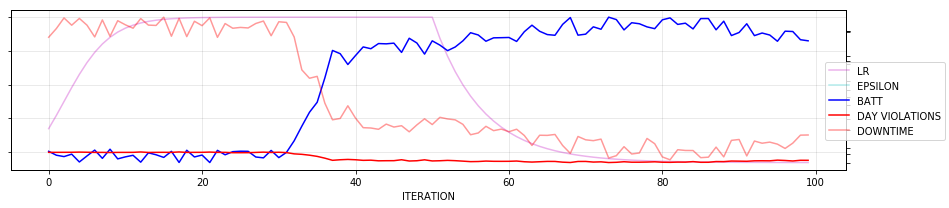

In [19]:
###########################################################################################
###########################################################################################

#PLOT LR AND EPSILON SCHEDULING
fig = plt.figure(figsize=(12,3))
ax = fig.add_subplot(111)
# ax.set_title("LR and EPSILON SCHEDULING V3")
ax.set_xlabel("ITERATION")
# ax.set_ylabel("LR",      color = 'm')
ax.plot(lr_rec,          color = 'm', alpha = 0.3,label="LR")
# ax.tick_params(axis='y', color = 'm')
# ax.ticklabel_format(style='sci', axis='y', scilimits=(-6,-7))
# ax.minorticks_on()

# ax.set_axisbelow(True)
ax.yaxis.set_ticklabels([])

ax.grid(b=True, which='minor', linestyle=':',  color='k', alpha = 0.1)
ax.grid(b=True, which='major', linestyle='-',  color='k', alpha = 0.1)

ax_ = ax.twinx()
# ax_.set_ylabel("EPSILON", color = 'c')
# ax_.tick_params(axis='y', color = 'c')
# ax_.set_axisbelow(True)
# ax_.minorticks_on()
ax_.plot(e_rec,           color = 'c', alpha = 0.3, label="EPSILON")
ax_.yaxis.set_ticklabels([])

# Plot the average reward log
ax1 = ax.twinx()
# ax1.set_ylabel("Terminal Reward", color = 'b')
# ax1.set_ylim([-10,2]);
ax1.plot(avg_reward_rec,'b',label="BATT")
# ax1.tick_params(axis='y', colors='b')
ax1.yaxis.set_ticklabels([])

# Plot the violation record log
ax2 = ax.twinx()
# ax2.set_ylabel("Violations",color = 'r')
ax2.plot(day_violation_rec,'r', label="DAY VIOLATIONS")
ax2.plot(batt_violation_rec,'r',alpha=0.4, label="DOWNTIME")
for xpt in np.argwhere(batt_violation_rec<1):
    ax2.axvline(x=xpt,color='g',linewidth='0.5')
# ax2.set_ylim([0,50]);
# ax2.tick_params(axis='y', colors='r')
ax2.yaxis.set_ticklabels([])

fig.legend(bbox_to_anchor=(1.1, 0.7))


fig.tight_layout()

###########################################################################################
###########################################################################################

In [20]:
# print("ITERATION #0 :  LR = {:4.2e} @ EPSILON = {:4.2f}".format(lr_rec[0],e_rec[0]))
# print("ITERATION #10:  LR = {:4.2e} @ EPSILON = {:4.2f}".format(lr_rec[10],e_rec[10]))
# print("ITERATION #20:  LR = {:4.2e} @ EPSILON = {:4.2f}".format(lr_rec[20],e_rec[20]))
# print("ITERATION #50:  LR = {:4.2e} @ EPSILON = {:4.2f}".format(lr_rec[50],e_rec[50]))
# print("ITERATION #80:  LR = {:4.2e} @ EPSILON = {:4.2f}".format(lr_rec[80],e_rec[80]))
# print("ITERATION #99:  LR = {:4.2e} @ EPSILON = {:4.2f}".format(lr_rec[99],e_rec[99]))

In [21]:
S_FILENAME = './models/'+ 'demo_'+ MODELNAME
# S_FILENAME = './models/'+ MODELNAME
print("Loading MODEL from FILE: ", S_FILENAME)
dqn = DQN()
dqn.eval_net.load_state_dict(torch.load(S_FILENAME))
dqn.eval_net.eval()
print("DEVICE: ", dqn.device)

Loading MODEL from FILE:  ./models/demo_B1_2_wakkanai_alt_depth2_w100_314.pt
DEVICE:  cpu


***MEASURING PERFORMANCE OF THE MODEL***


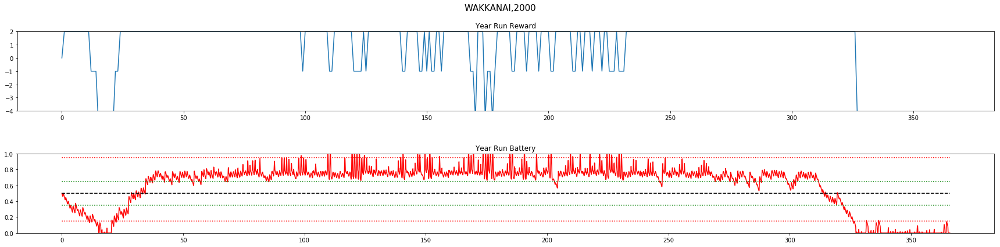

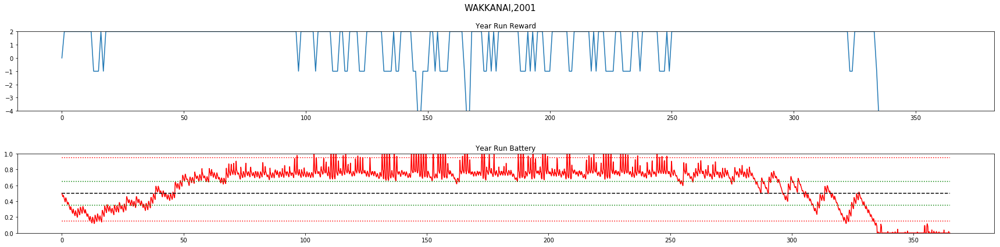

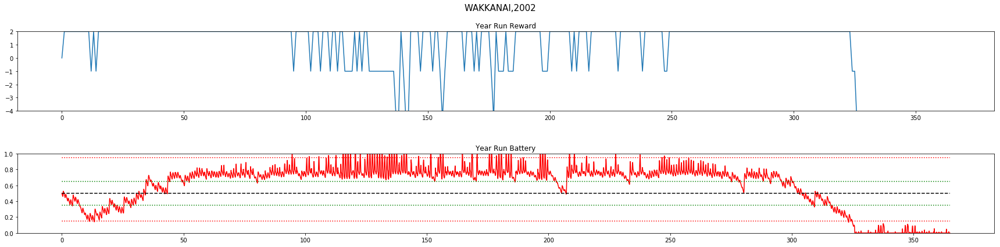

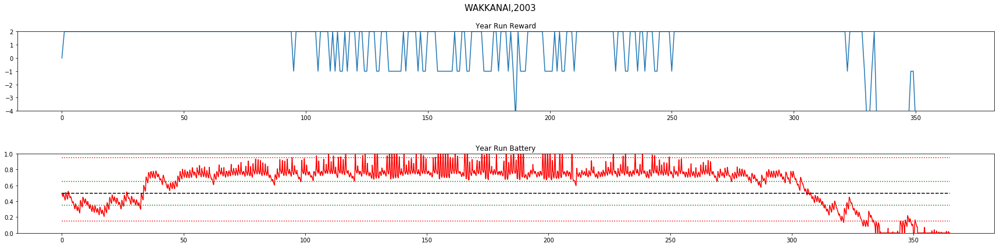

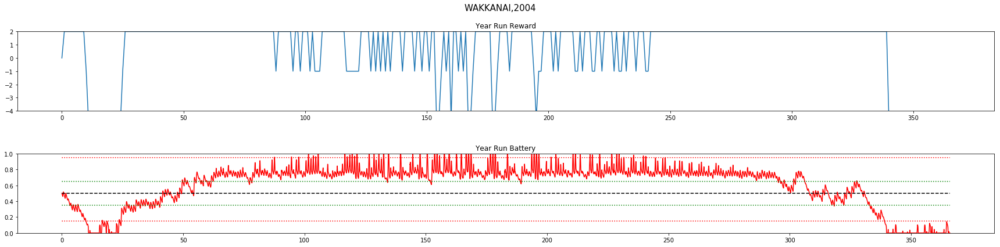

...

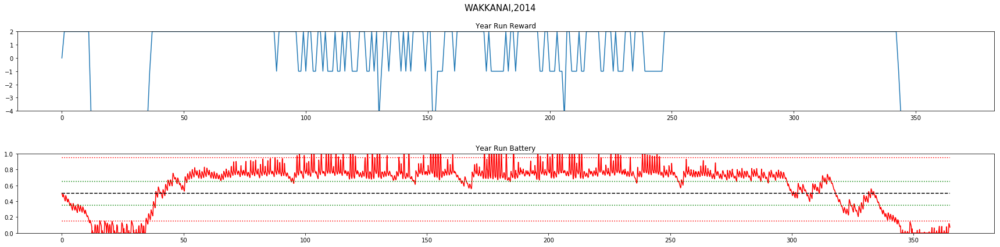

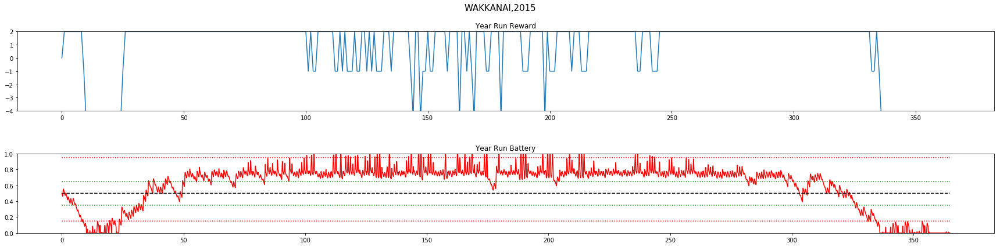

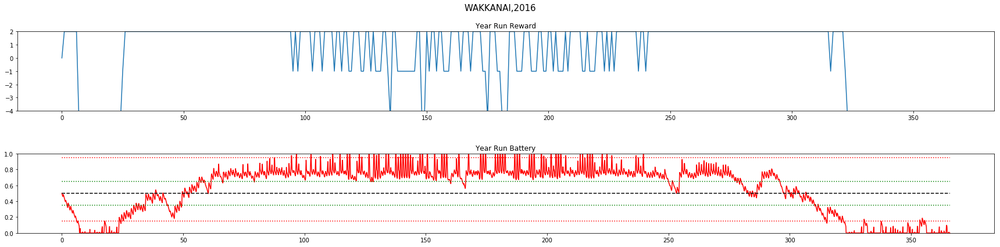

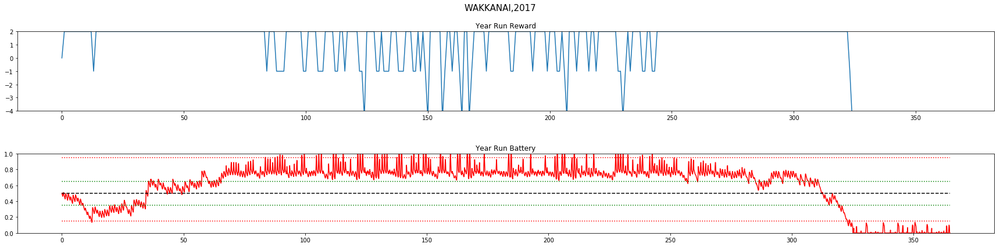

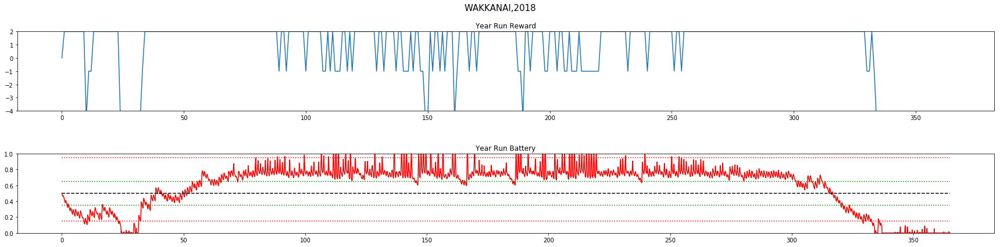



WAKKANAI
YEAR	AVG_RWD		VIOLATIONS
			DAY	BATT
2000	 0.61		93	 977
2001	 0.75		98	 795
2002	 0.62		97	 970
2003	 0.8		97	 649
2004	 0.6		98	 834
2005	 0.68		107	 679
2006	 0.88		84	 721
2007	 0.73		100	 775
2008	 0.59		101	 822
2009	 0.25		122	 1044
2010	 0.75		89	 753
2011	 0.71		92	 840
2012	 0.65		94	 964
2013	 0.48		100	 988
2014	 0.43		117	 849
2015	 0.58		98	 810
2016	 0.08		129	 1294
2017	 0.56		101	 908
2018	 0.6		101	 938

TOTAL Day Violations:   1918.0
TOTAL Batt Violations:  16610.0
************************************


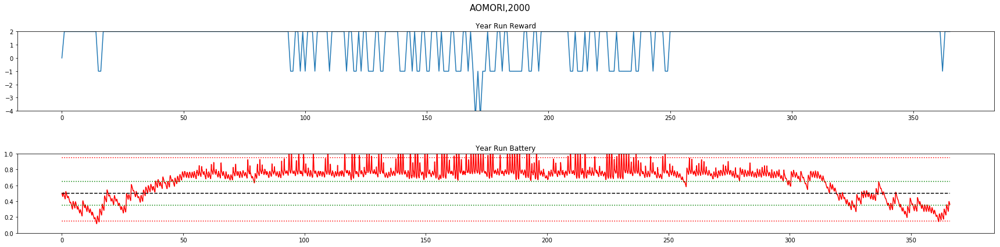

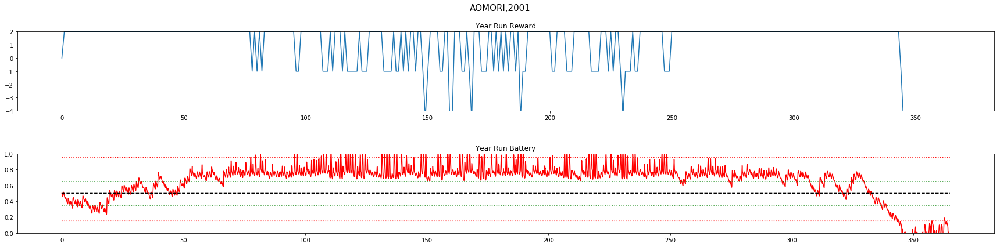

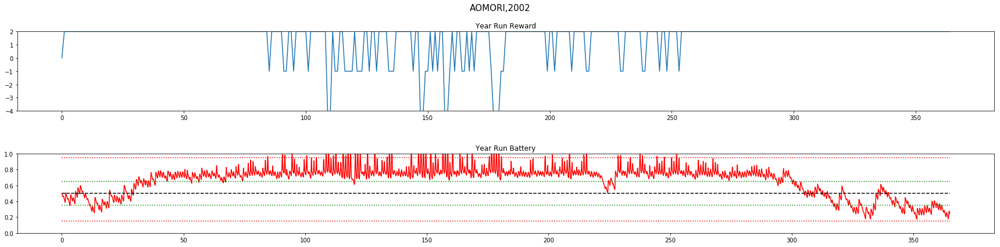

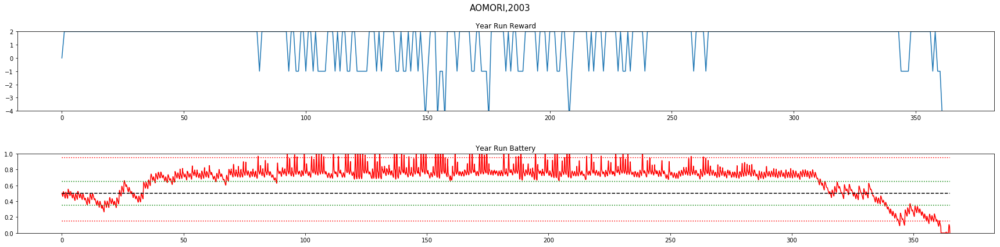

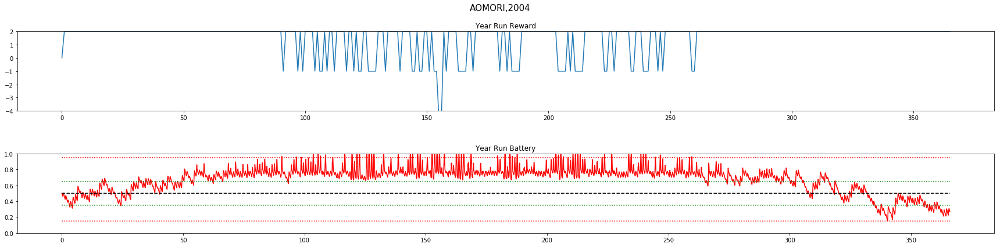

...

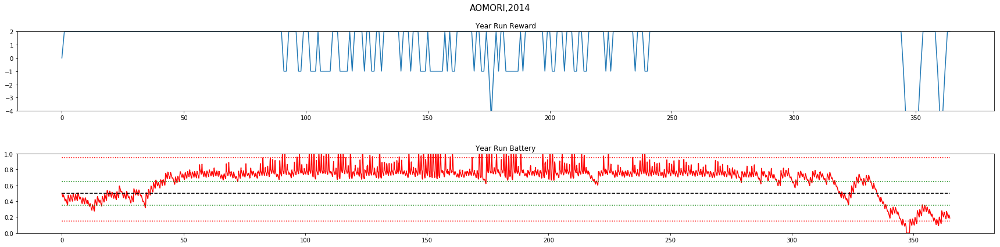

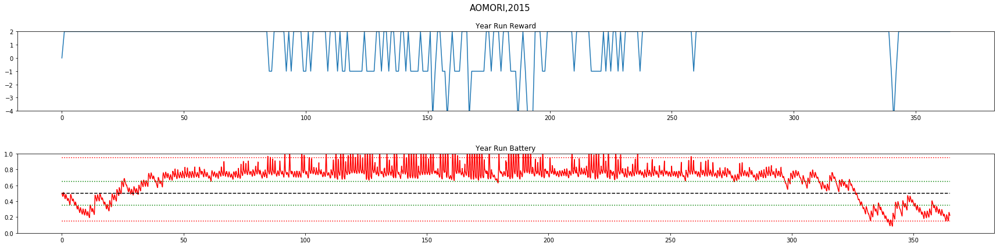

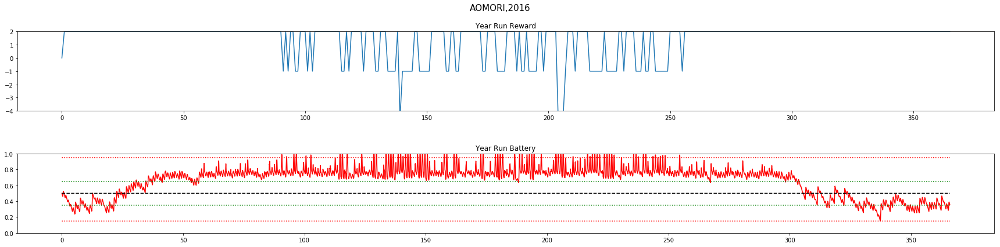

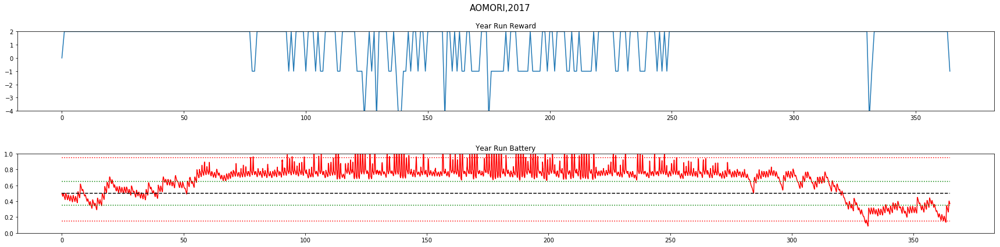

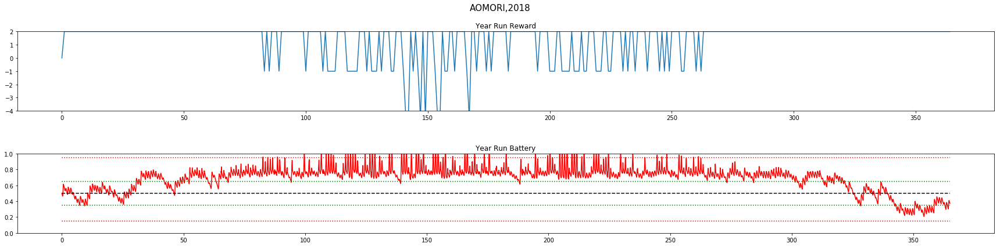



AOMORI
YEAR	AVG_RWD		VIOLATIONS
			DAY	BATT
2000	 1.37		74	 182
2001	 0.93		92	 512
2002	 1.46		54	 135
2003	 1.29		75	 207
2004	 1.48		60	 133
2005	 1.41		65	 129
2006	 1.48		62	 138
2007	 1.31		74	 200
2008	 1.32		75	 193
2009	 1.37		73	 122
2010	 1.4		66	 129
2011	 0.94		91	 467
2012	 1.2		85	 177
2013	 1.53		53	 142
2014	 1.29		74	 181
2015	 1.28		77	 218
2016	 1.35		74	 196
2017	 1.29		77	 186
2018	 1.36		69	 153

TOTAL Day Violations:   1370.0
TOTAL Batt Violations:  3800.0
************************************


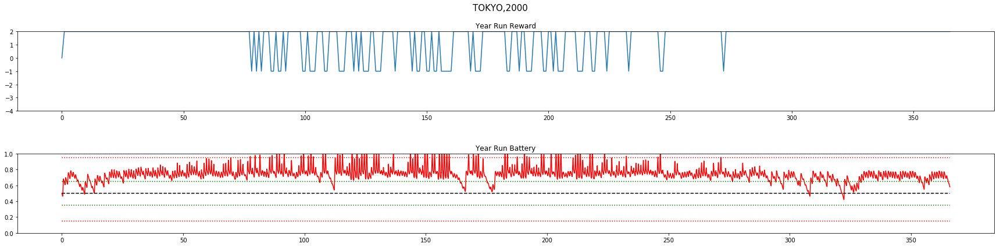

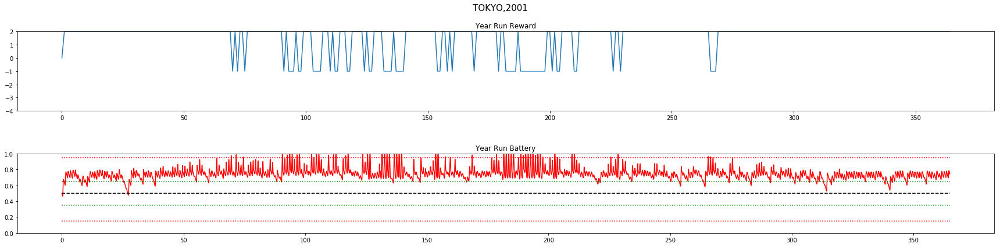

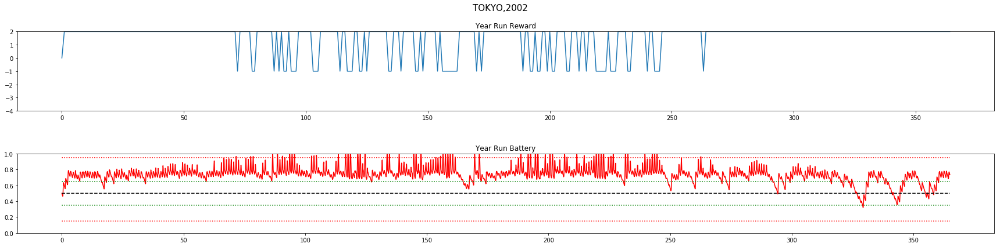

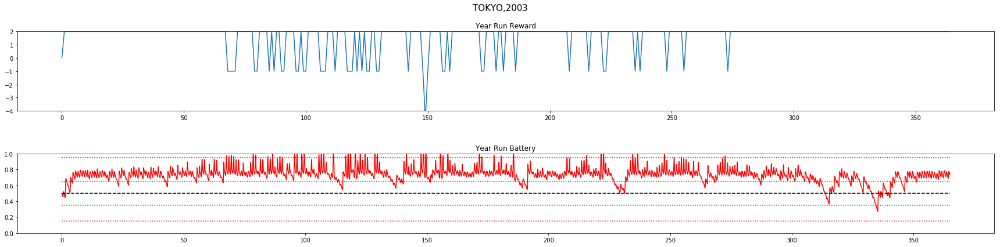

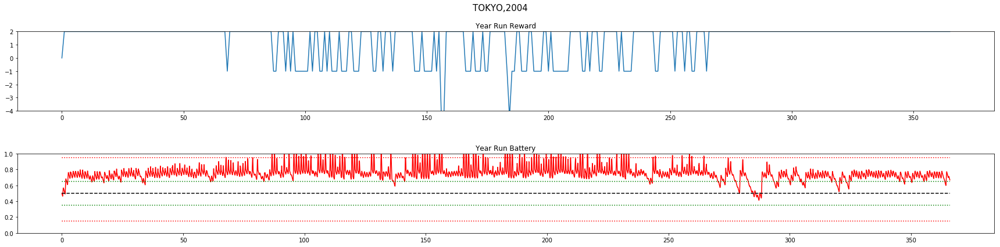

...

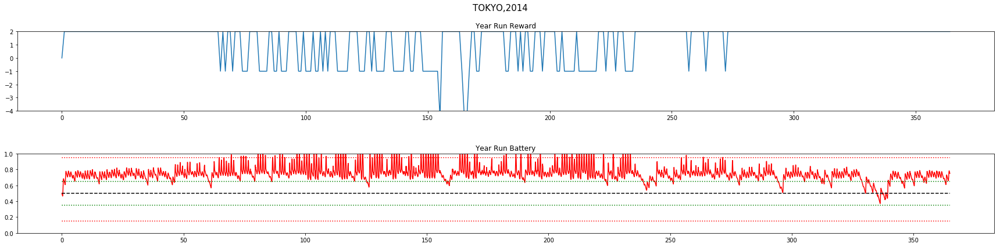

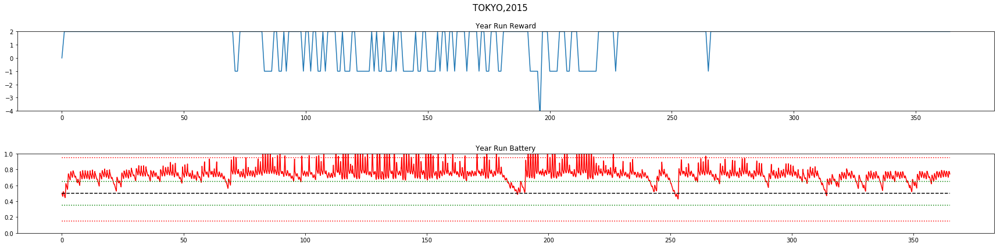

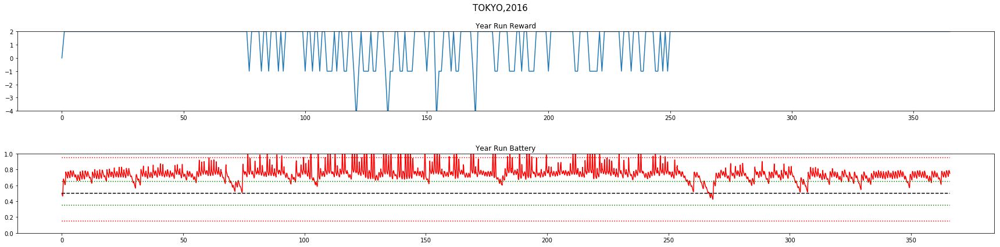

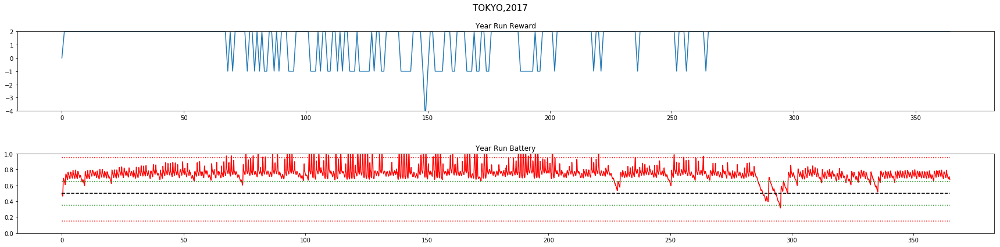

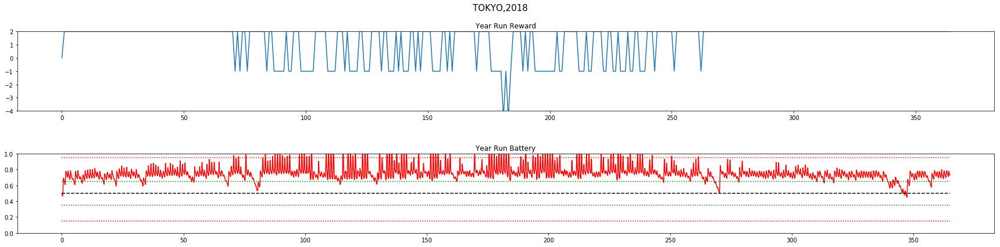



TOKYO
YEAR	AVG_RWD		VIOLATIONS
			DAY	BATT
2000	 1.46		65	 118
2001	 1.49		61	 129
2002	 1.48		63	 137
2003	 1.59		48	 66
2004	 1.29		82	 175
2005	 1.45		65	 63
2006	 1.63		44	 69
2007	 1.42		68	 152
2008	 1.57		51	 77
2009	 1.51		59	 135
2010	 1.37		76	 165
2011	 1.38		73	 161
2012	 1.34		77	 170
2013	 1.27		87	 179
2014	 1.23		89	 209
2015	 1.38		73	 177
2016	 1.42		65	 154
2017	 1.43		67	 171
2018	 1.25		88	 213

TOTAL Day Violations:   1301.0
TOTAL Batt Violations:  2720.0
************************************


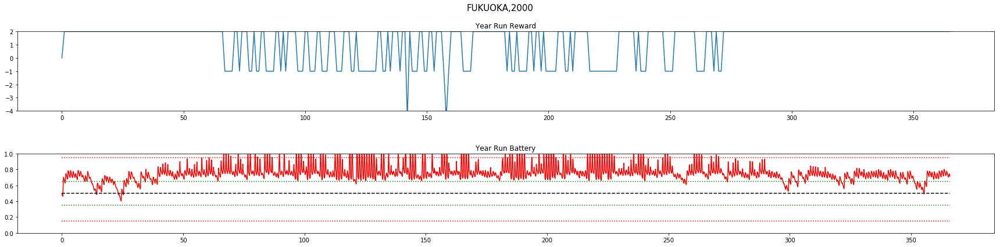

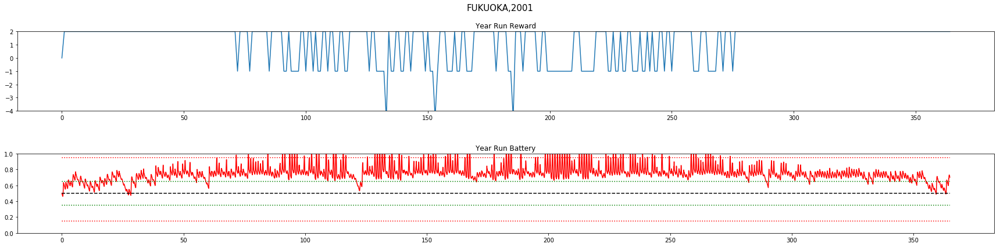

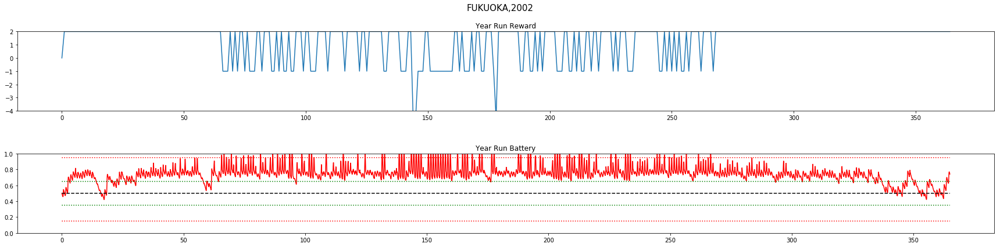

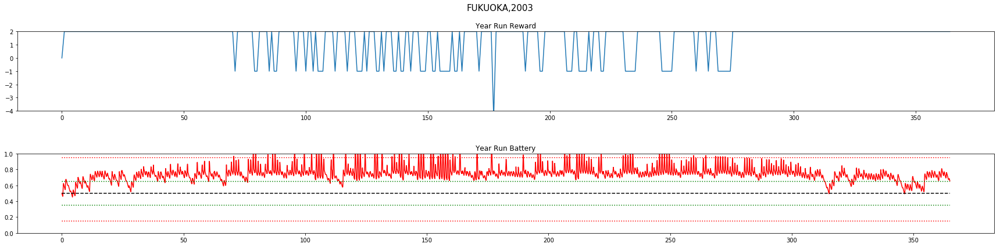

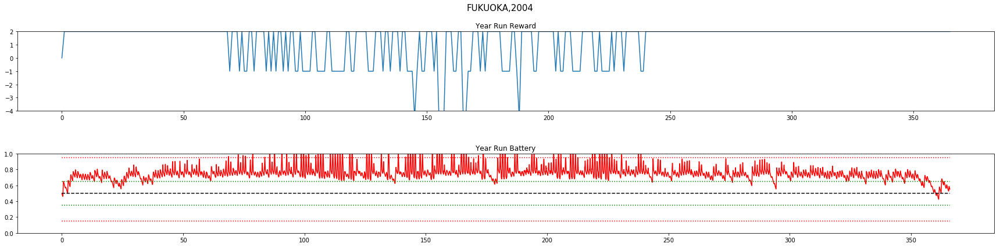

...

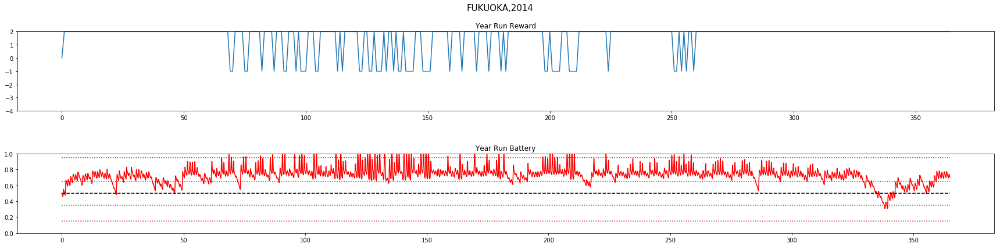

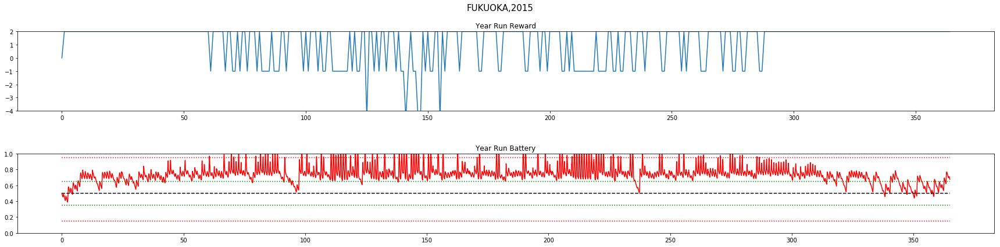

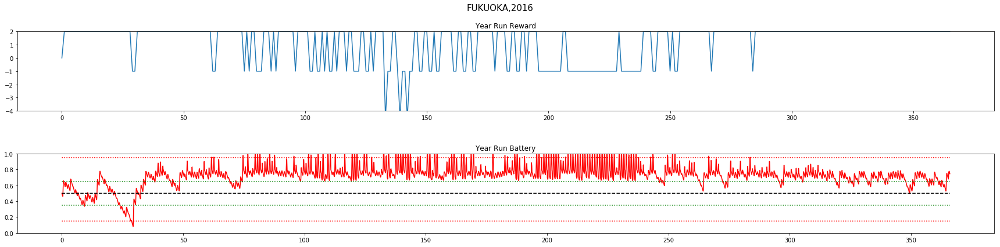

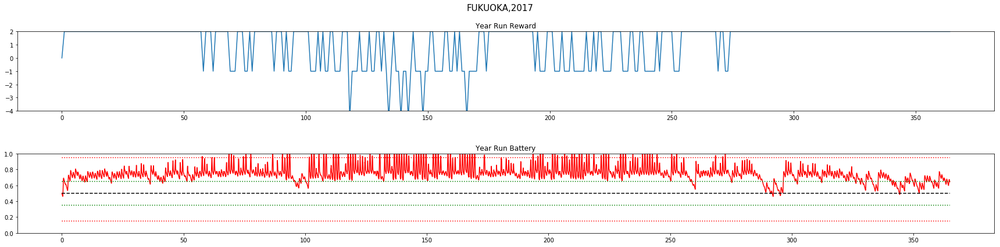

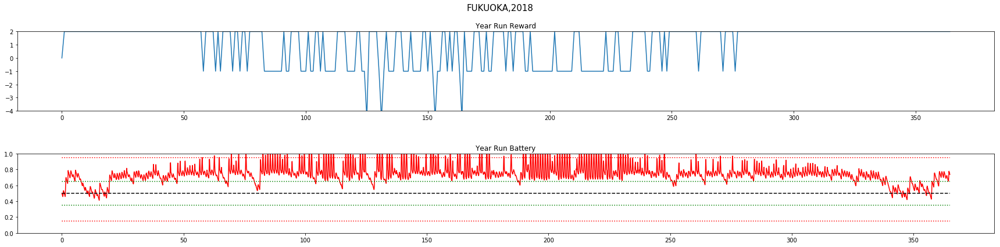



FUKUOKA
YEAR	AVG_RWD		VIOLATIONS
			DAY	BATT
2000	 1.16		99	 253
2001	 1.22		91	 205
2002	 1.27		85	 230
2003	 1.39		72	 165
2004	 1.29		78	 198
2005	 1.2		93	 215
2006	 1.35		79	 158
2007	 1.25		87	 228
2008	 1.28		84	 159
2009	 1.26		88	 203
2010	 1.3		80	 157
2011	 1.44		68	 86
2012	 1.47		63	 121
2013	 1.38		75	 150
2014	 1.53		57	 111
2015	 1.17		94	 249
2016	 1.13		102	 250
2017	 1.11		101	 259
2018	 1.07		108	 321

TOTAL Day Violations:   1604.0
TOTAL Batt Violations:  3718.0
************************************


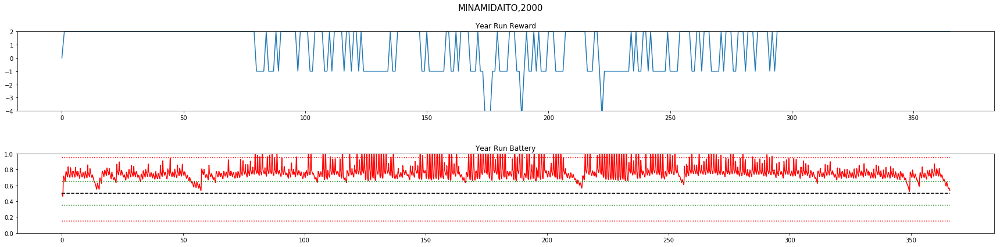

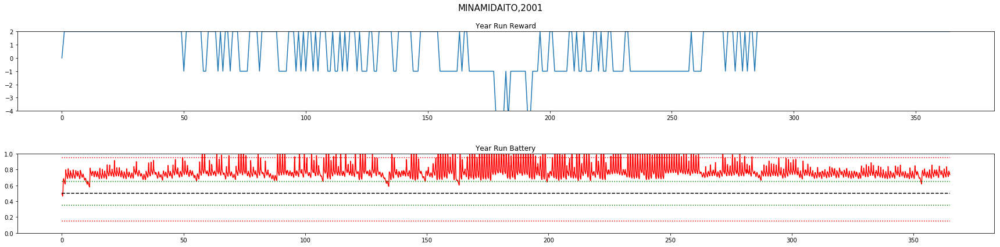

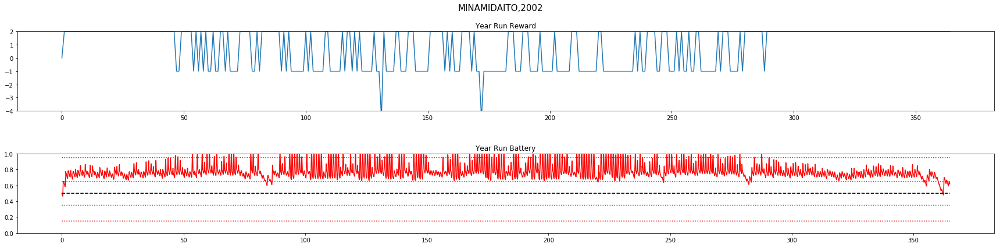

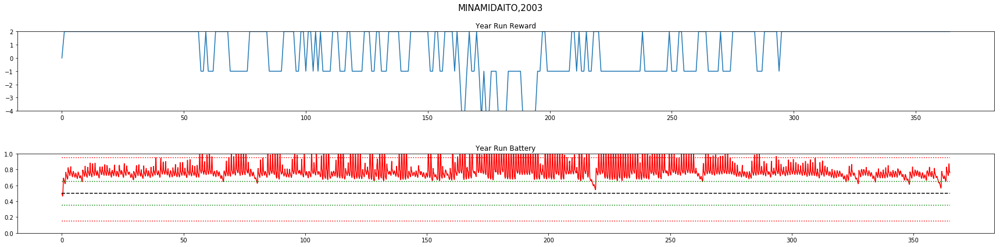

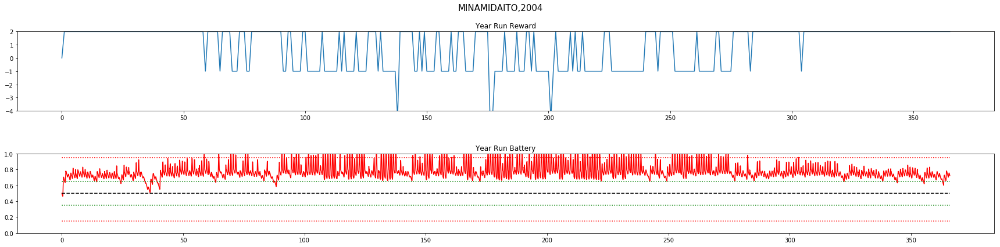

...

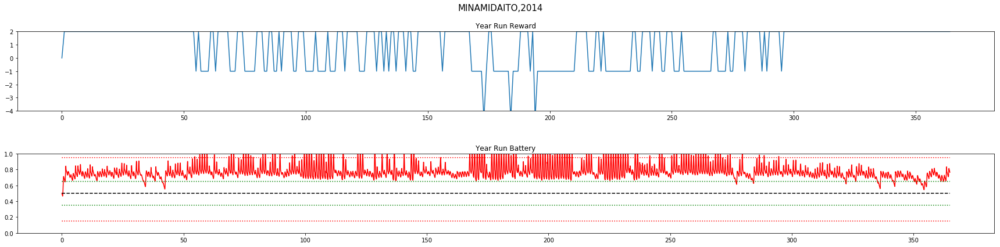

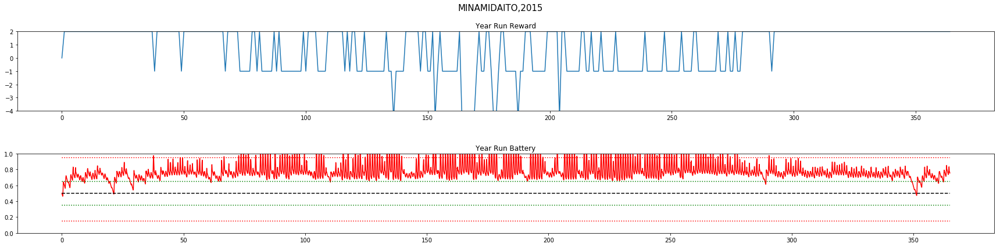

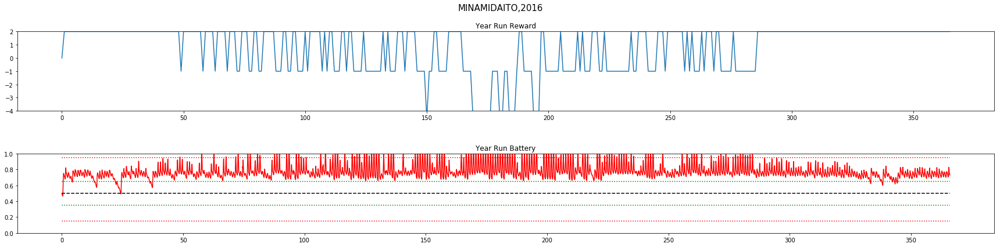

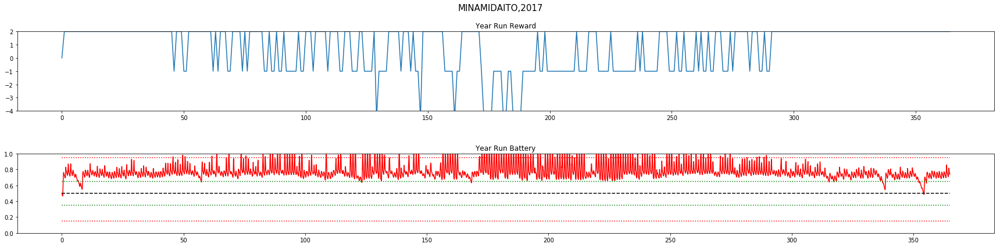

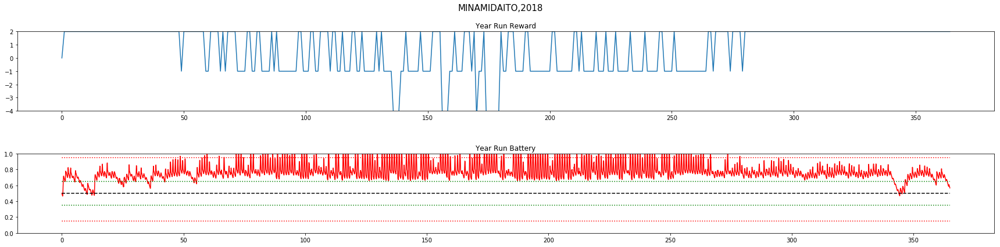



MINAMIDAITO
YEAR	AVG_RWD		VIOLATIONS
			DAY	BATT
2000	 1.01		114	 331
2001	 0.84		132	 347
2002	 0.78		145	 375
2003	 0.65		146	 448
2004	 0.85		135	 348
2005	 0.92		127	 297
2006	 0.8		136	 418
2007	 0.92		123	 307
2008	 0.87		132	 276
2009	 0.81		141	 402
2010	 0.93		122	 318
2011	 0.93		121	 328
2012	 1.05		107	 239
2013	 0.82		137	 370
2014	 0.94		125	 335
2015	 0.65		149	 434
2016	 0.7		138	 360
2017	 0.75		136	 364
2018	 0.65		148	 459

TOTAL Day Violations:   2514.0
TOTAL Batt Violations:  6756.0
************************************


In [22]:
#VALIDATION PHASE
print("***MEASURING PERFORMANCE OF THE MODEL***")
for LOCATION in ['wakkanai','aomori','tokyo','fukuoka','minamidaito']:
    results = np.empty(4)

    for YEAR in np.arange(2000,2019):
        capm      = CAPM(LOCATION,YEAR,shuffle=False, trainmode=False) #instantiate the CAPM class
        capm.eno  = ENO(LOCATION,YEAR, shuffle=False, day_balance=False) #instantiate the environment inside the CAPM class
        capm.HMAX = capm.eno.SMAX #maximum power output of solar cell is set in CAPM object using the value in ENO object

        s, r, day_end, year_end = capm.reset()
        yr_test_record = np.empty(4)

        while True:
            a = dqn.choose_greedy_action(stdize(s))
            yr_test_record = np.vstack((yr_test_record, [s[0],s[2],r, a])) #record battery, henergy, reward and action
            s_, r, day_end, year_end = capm.step(a)
            if year_end:
                break
            s = s_

        yr_test_record = np.delete(yr_test_record, 0, 0) #remove the first row which is garbage
        yr_test_reward_rec = yr_test_record[:,2]
        yr_test_reward_rec = yr_test_reward_rec[::24] #annual average reward
        results = np.vstack((results, [int(YEAR), np.mean(yr_test_reward_rec), int(capm.violation_counter), int(capm.batt_violations)]))

    ###########################################################################################
    ###########################################################################################
        #     Plot the reward and battery for the entire year run
        title = LOCATION.upper() + ',' + str(YEAR)
        NO_OF_DAYS = capm.eno.NO_OF_DAYS

        fig = plt.figure(figsize=(24,6))
        fig.suptitle(title, fontsize=15)

        ax1 = fig.add_subplot(211)
        ax1.plot(yr_test_reward_rec)
        ax1.set_title("\n\nYear Run Reward")
        ax1.set_ylim([-4,2])

        ax2 = fig.add_subplot(212)
        ax2.plot(yr_test_record[:,0],'r')
        ax2.plot(np.ones_like(yr_test_record[:,0])*capm.BOPT/capm.BMAX, 'k--')
        ax2.plot(np.ones_like(yr_test_record[:,0])*capm.BLIM_LO/capm.BMAX, 'r:')
        ax2.plot(np.ones_like(yr_test_record[:,0])*capm.BLIM_HI/capm.BMAX, 'r:')
        ax2.plot(np.ones_like(yr_test_record[:,0])*(capm.BOPT+capm.ENP_MARGIN /2) /capm.BMAX, 'g:')
        ax2.plot(np.ones_like(yr_test_record[:,0])*(capm.BOPT-capm.ENP_MARGIN/2)/capm.BMAX, 'g:')

        ax2.set_title("\n\nYear Run Battery")
        ax2.set_ylim([0,1])
        plt.sca(ax2)
        plt.xticks(np.arange(0, NO_OF_DAYS*24, 50*24),np.arange(0,NO_OF_DAYS,50))
        fig.tight_layout()
        plt.show()
    ###########################################################################################
    ###########################################################################################
    results = np.delete(results,0,0)
    print("\n")
    print(LOCATION.upper())
    print('YEAR\tAVG_RWD\t\tVIOLATIONS')
    print('\t\t\tDAY\tBATT')

    for x in np.arange(0,results.shape[0]):
        print('{}\t {}\t\t{}\t {}'.format(int(results[x,0]), np.around(results[x,1],2), int(results[x,2]), int(results[x,-1])))

    print("\nTOTAL Day Violations:  ",np.sum(results[:, 2]))
    print("TOTAL Batt Violations: ",np.sum(results[:,-1]))
    print("************************************")

In [23]:
print('\nRun time: {}'.format(datetime.now() - tic))


Run time: 0:23:31.461110


In [24]:
LOCATION = 'tokyo'
YEAR = 2000

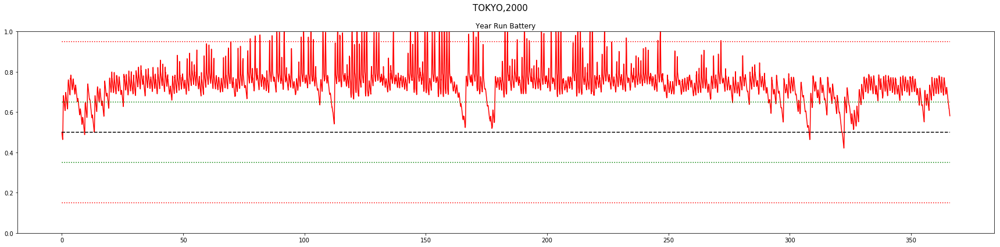

In [25]:
capm = CAPM(LOCATION,YEAR,shuffle=False, trainmode=False) #instantiate the CAPM class
capm.eno = ENO(LOCATION,YEAR, shuffle=False, day_balance=False) #instantiate the environment inside the CAPM class
capm.HMAX = capm.eno.SMAX #maximum power output of solar cell is set in CAPM object using the value in ENO object

s, r, day_end, year_end = capm.reset()
yr_test_record = np.empty(4)

while True:
    a = dqn.choose_greedy_action(stdize(s))

    #state = [batt, enp, henergy, fcast]
    yr_test_record = np.vstack((yr_test_record, [s[0],s[2],r, a])) #record battery, henergy, reward and action

    # take action
    s_, r, day_end, year_end = capm.step(a)

    if year_end:
        break

    s = s_

yr_test_record = np.delete(yr_test_record, 0, 0) #remove the first row which is garbage
yr_test_reward_rec = yr_test_record[:,2]
yr_test_reward_rec = yr_test_reward_rec[::24]

title = LOCATION.upper() + ',' + str(YEAR)
NO_OF_DAYS = capm.eno.NO_OF_DAYS

fig = plt.figure(figsize=(24,6))
fig.suptitle(title, fontsize=15)

#     ax1 = fig.add_subplot(211)
#     ax1.plot(yr_test_reward_rec)
#     ax1.set_title("\n\nYear Run Reward")
#     ax1.set_ylim([-3,3])

#Plot the reward and battery for the entire year run
ax2 = fig.add_subplot(111)
ax2.plot(yr_test_record[:,0],'r')
ax2.plot(np.ones_like(yr_test_record[:,0])*capm.BOPT/capm.BMAX, 'k--')
ax2.plot(np.ones_like(yr_test_record[:,0])*capm.BLIM_LO/capm.BMAX, 'r:')
ax2.plot(np.ones_like(yr_test_record[:,0])*capm.BLIM_HI/capm.BMAX, 'r:')
ax2.plot(np.ones_like(yr_test_record[:,0])*(capm.BOPT+capm.ENP_MARGIN /2) /capm.BMAX, 'g:')
ax2.plot(np.ones_like(yr_test_record[:,0])*(capm.BOPT-capm.ENP_MARGIN/2)/capm.BMAX, 'g:')
ax2.set_title("\n\nYear Run Battery")
ax2.set_ylim([0,1])
plt.sca(ax2)
plt.xticks(np.arange(0, NO_OF_DAYS*24, 50*24),np.arange(0,NO_OF_DAYS,50))
fig.tight_layout()
plt.show()

In [26]:
DAY_START = 320
DAY_END   = 325

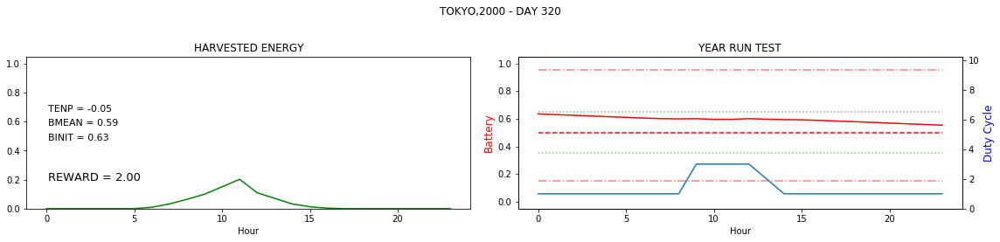

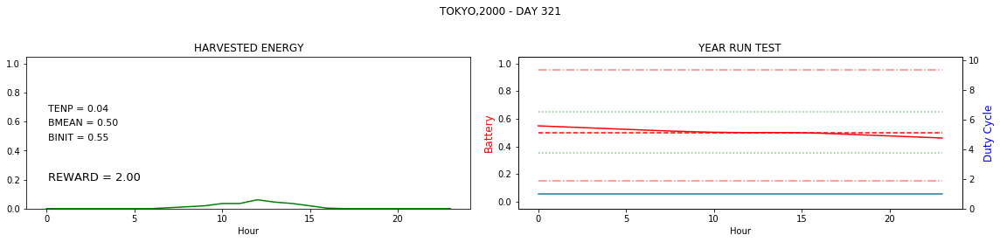

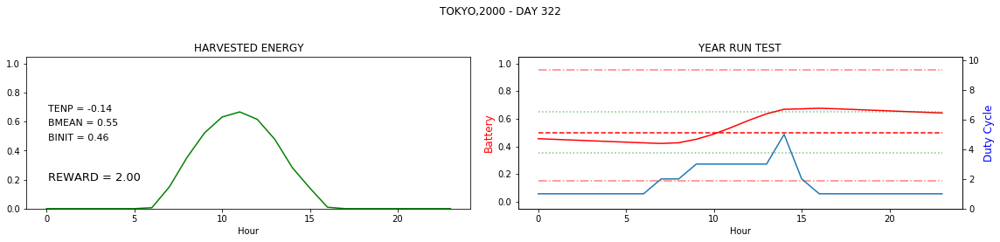

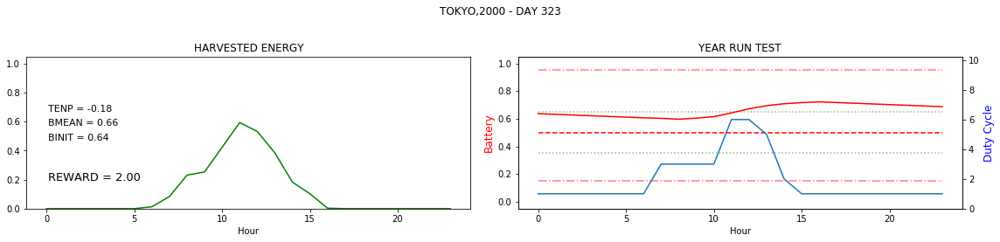

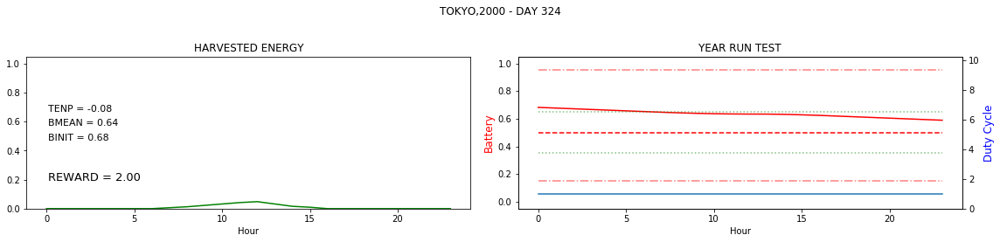

In [27]:
#Plot the reward and battery for the entire year run on a day by day basis
title = LOCATION.upper() + ',' + str(YEAR)
TIME_AXIS = np.arange(0,capm.eno.TIME_STEPS)
for DAY in range(DAY_START,DAY_END):
    START = DAY*24
    END = START+24

    daytitle = title + ' - DAY ' + str(DAY)
    fig = plt.figure(figsize=(16,4))
    st = fig.suptitle(daytitle)

    ax2 = fig.add_subplot(121)
    ax2.plot(yr_test_record[START:END,1],'g')
    ax2.set_title("HARVESTED ENERGY")
    ax2.set_xlabel("Hour")
    ax2.set_ylim([0,1.05])
    
    ax2.text(0.1, 0.6, "TENP = %.2f\n" %(capm.BOPT/capm.BMAX-yr_test_record[END,0]),fontsize=11, ha='left')
    ax2.text(0.1, 0.5, "BMEAN = %.2f\n" %(np.mean(yr_test_record[START:END,0])),fontsize=11, ha='left')
    ax2.text(0.1, 0.4, "BINIT = %.2f\n" %(yr_test_record[START,0]),fontsize=11, ha='left')
    if END < (capm.eno.NO_OF_DAYS*capm.eno.TIME_STEPS):
        ax2.text(0.1, 0.1, "REWARD = %.2f\n" %(yr_test_record[END,2]),fontsize=13, ha='left')
        
    #plot battery for year run
    ax1 = fig.add_subplot(122)
    ax1.plot(TIME_AXIS,              yr_test_record[START:END,0],'r')
    ax1.plot(TIME_AXIS, np.ones_like(yr_test_record[START:END,0])*capm.BOPT/capm.BMAX, 'r--')
    ax1.plot(TIME_AXIS, np.ones_like(yr_test_record[START:END,0])*capm.BLIM_LO/capm.BMAX, 'r-.',alpha=0.5)
    ax1.plot(TIME_AXIS, np.ones_like(yr_test_record[START:END,0])*capm.BLIM_HI/capm.BMAX, 'r-.',alpha=0.5)
    ax1.plot(TIME_AXIS, np.ones_like(yr_test_record[START:END,0])*(capm.BOPT+capm.ENP_MARGIN /2) /capm.BMAX, 'g:',alpha=0.5)
    ax1.plot(TIME_AXIS, np.ones_like(yr_test_record[START:END,0])*(capm.BOPT-capm.ENP_MARGIN/2)/capm.BMAX, 'g:',alpha=0.5)
    
    ax1.set_title("YEAR RUN TEST")
    ax1.set_xlabel("Hour")
    ax1.set_ylabel('Battery', color='r',fontsize=12)
    ax1.set_ylim([-0.05,1.05])

    #plot actions for year run
    ax1a = ax1.twinx()
    ax1a.plot(yr_test_record[START:END,3]+1)
    ax1a.set_ylim([0,N_ACTIONS])
    ax1a.set_ylabel('Duty Cycle', color='b',fontsize=12)
    ax1a.set_ylim([0,10.25])


    fig.tight_layout()
    st.set_y(0.95)
    fig.subplots_adjust(top=0.75)
    plt.show()